# NILM POC

## First model: Disaggregated Signal

### Imports

In [2]:
# import tensorflow as tf
# print(tf.__version__)
import tf_keras as keras
# from tensorflow import keras
# import tf_keras as keras
# import keras as keras

# from tf.keras.datasets import fashion_mnist
from keras.models import Sequential, Model
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D, Conv1D, MaxPooling1D
from keras.utils import to_categorical
from keras.layers import Conv1D, Dense, Flatten, Input, LSTM, Dropout, BatchNormalization, TimeDistributed, Bidirectional
# from tensorflow.keras.utils.np_utils import to_categorical

import pandas as pd
import numpy as np
from pathlib import Path
import os
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import itertools
from sklearn.metrics import confusion_matrix
import tempfile

In [4]:
import os
import numpy as np
import pandas as pd
from pathlib import Path
import random


# Parameters
WINDOW_SIZE = 300
STEP_SIZE = 275
TOLERANCE = 0.1
MAX = 20000
DATA_DIR = str(Path.cwd().parent.parent / 'Reffit' / 'Processed')
LABELS = []
X = []
y = []
well_represented = ['Fridge','Freezer','Washing Machine','Washer Dryer','Tumble Dryer','Dishwasher','Microwave','Toaster','Kettle',
                'Computer','Electric Heater','Hi-Fi','Overhead Fan']


### Loading the data

In [65]:
# Function to extract overlapping windows from a signal
def extract_windows(signal):
    signal = signal / np.max(np.abs(signal)) if np.max(np.abs(signal)) > 0 else signal
    windows = []
    for start in range(0, len(signal) - WINDOW_SIZE, STEP_SIZE):
        window = signal[start:start + WINDOW_SIZE]
        windows.append(window)
    return windows

# Function to process a single file and extract windows
def process_file(file_path, label_idx):
    print(f"Processing file: {file_path}")
    df = pd.read_csv(file_path)
    with open(file_path) as f:
        appliance_name = f.readline().strip().split(",")[1]

    if appliance_name not in df.columns:
        return []

    signal = df[appliance_name].fillna(0).values.astype(np.float32)
    return [(window, label_idx) for window in extract_windows(signal)]

# Function to load and balance the dataset
def load_balanced_dataset(data_dir, well_represented=well_represented):
    global LABELS, X, y

    label_map = {name: i for i, name in enumerate(well_represented)}
    all_windows = {label: [] for label in well_represented}

    # Step 1: Load all data first
    for class_dir in sorted(Path(data_dir).iterdir()):
        if not class_dir.is_dir():
            continue
        class_name = class_dir.name
        if class_name not in well_represented:
            continue
        label_idx = label_map[class_name]
        if class_name not in LABELS:
            LABELS.append(class_name)
        for file in class_dir.glob("*.csv"):
            windows = process_file(file, label_idx)
            all_windows[class_name].extend(windows)

    # Select reference class and determine target range
    ref_class = random.choice(well_represented)
    original_ref_count = len(all_windows[ref_class])
    ref_count = min(MAX, original_ref_count)
    print(f"Reference class: {ref_class} (using {ref_count} windows, originally had {original_ref_count})")

    min_required = int(ref_count * (1 - TOLERANCE))
    max_allowed = int(ref_count * (1 + TOLERANCE))
    cap = min(MAX, max_allowed)


    # Apply sampling per class
    for label in well_represented:
        class_windows = all_windows[label]

        needed = MAX

        if len(class_windows) >= needed:
            chosen = random.sample(class_windows, needed)
        else:
            repeat_count = (needed // len(class_windows)) + 1
            extended = class_windows * repeat_count
            chosen = extended[:needed]
            chosen = [(w + np.random.normal(0, 0.01, size=w.shape).astype(np.float32), lbl)
                      for (w, lbl) in chosen]

        for window, label_idx in chosen:
            X.append(window)
            y.append(label_idx)

        print(f"{label}: {len(chosen)} samples")

    print("\nClass balance (target ±{:.1f}%, max cap = {}):".format(TOLERANCE * 100, MAX))
    for label in well_represented:
        print(f"{label}: {sum(np.array(y) == label_map[label])} windows")

    X_np = np.array(X)[..., np.newaxis]
    y_np = to_categorical(y, num_classes=len(LABELS))
    return X_np, y_np


X, y = load_balanced_dataset(DATA_DIR)

Processing file: c:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Reffit\Processed\Computer\Computer_House_1.csv_0.csv
Processing file: c:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Reffit\Processed\Computer\Computer_House_1.csv_1.csv
Processing file: c:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Reffit\Processed\Computer\Computer_House_1.csv_112.csv
Processing file: c:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Reffit\Processed\Computer\Computer_House_1.csv_115.csv
Processing file: c:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Reffit\Processed\Computer\Computer_House_1.csv_116.csv
Processing file: c:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Reffit\Processed\Computer\Computer_House_1.csv_117.csv
Processing file: c:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Reffit\Pr

### Seperating the data into train-test-validation class distribution: 

In [66]:

# Train-validation-test split

X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.3, random_state=42)

def print_class_distribution(y_set, set_name):
    class_counts = np.sum(y_set, axis=0)
    print(f"\nClass distribution in {set_name} set:")
    for idx, count in enumerate(class_counts):
        print(f"{LABELS[idx]:<20}: {int(count)} samples")

# Print stats
print_class_distribution(y_train, "TRAIN")
print_class_distribution(y_val, "VALIDATION")
print_class_distribution(y_test, "TEST")




Class distribution in TRAIN set:
Computer            : 12105 samples
Dishwasher          : 11943 samples
Electric Heater     : 12059 samples
Freezer             : 11983 samples
Fridge              : 12088 samples
Hi-Fi               : 11970 samples
Kettle              : 11951 samples
Microwave           : 12111 samples
Overhead Fan        : 11923 samples
Toaster             : 11999 samples
Tumble Dryer        : 11957 samples
Washer Dryer        : 11949 samples
Washing Machine     : 11962 samples

Class distribution in VALIDATION set:
Computer            : 5552 samples
Dishwasher          : 5672 samples
Electric Heater     : 5560 samples
Freezer             : 5646 samples
Fridge              : 5490 samples
Hi-Fi               : 5614 samples
Kettle              : 5627 samples
Microwave           : 5495 samples
Overhead Fan        : 5654 samples
Toaster             : 5613 samples
Tumble Dryer        : 5649 samples
Washer Dryer        : 5644 samples
Washing Machine     : 5584 samples

Cla

### First model

To run the model, the custom functions `relu6_div6()`, `Conv1DGLUBlock()` and `ResidualBlock()` need to be ran first. Altogether they create a custom layer used in the model

In [5]:
from keras.layers import Activation, Multiply, Add
from keras.utils import get_custom_objects
from keras.activations import relu
from keras.layers import Lambda


# Custom activation function: ReLU6 divided by 6
def relu6_div6(x):
    return relu(x, max_value=6) / 6

get_custom_objects().update({'relu6_div6': relu6_div6})

# Custom Gated-Linear-Unit Convolutionnal layers for the model
def Conv1DGLUBlock(filters, kernel_size):
    def block(x):
        linear = Conv1D(filters, kernel_size, padding='same')(x)
        gate = Conv1D(filters, kernel_size, padding='same')(x)
        gate_out = Activation(relu6_div6)(gate)
        # gate_out = Lambda(lambda x: relu(x, max_value=6) / 6)(gate)
        return Multiply()([linear, gate_out])
    return block

get_custom_objects().update({'Conv1DGLUBlock': Conv1DGLUBlock})

# Custom Residual Block with GLU
def ResidualBlock(filters, kernel_size):
    def block(x):
        out = Conv1DGLUBlock(filters, kernel_size)(x)
        out = Conv1D(filters, kernel_size=1, padding='same')(out)
        if x.shape[-1] != out.shape[-1]:
            x = Conv1D(filters, kernel_size=1, padding='same')(x)  # 1x1 conv to match channels
        return Add()([x, out])
    return block
get_custom_objects().update({'ResidualBlock': ResidualBlock})

The following cell contains `build_glu_cnn_lstm_model()` that is responsible for the generation of the model.

In [119]:
from keras.models import Model
from keras.layers import Add

# Build the model using the custom GLU blocks
def build_glu_cnn_lstm_model(window_size, num_classes):
    input_layer = Input(shape=(window_size, 1))
    print(f"Input shape: {input_layer.shape}")


    x = ResidualBlock(filters=64, kernel_size=5)(input_layer)
    x = MaxPooling1D(pool_size=2, strides=2)(x)

    print(f"Input shape: {x.shape}")
    x = ResidualBlock(filters=128, kernel_size=3)(x)
    x = MaxPooling1D(pool_size=2, strides=2)(x)

    x = Dropout(0.2)(x)

    # Optional LSTM
    x = LSTM(64)(x)

    x = Dense(128, activation='relu')(x)
    x = Dropout(0.3)(x)

    output_layer = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    return model


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

# Early stopping to prevent overfitting : NOT USED
early_stopping = EarlyStopping(
    monitor='val_loss',       # or 'val_accuracy'
    patience=5,               # number of epochs with no improvement before stopping
    restore_best_weights=True
)

To start training the model in `build_glu_cnn_lstm_model()`, run the following cell. The model will use the loaded trainng data from earlier, and train over **15 epochs** with **batches of size 64**.

In [120]:
model = build_glu_cnn_lstm_model(WINDOW_SIZE, num_classes=len(LABELS))
model.summary()

history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=15,
    batch_size=64,
    verbose=1
)


Input shape: (None, 300, 1)
Input shape: (None, 150, 64)


Model: "functional_22"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_13      │ (None, 300, 1)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_159 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_158 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_73       │ (None, 300, 64)   │          0 │ conv1d_159[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_44         │ (None, 300, 64)   │          0 │ conv1d_158[0][0], │
│ (Multiply)          │                   │            │ activation_73[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_161 (Conv1D) │ (None, 300, 64)   │        128 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_160 (Conv1D) │ (None, 300, 64)   │      4,160 │ multiply_44[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_44 (Add)        │ (None, 300, 64)   │          0 │ conv1d_161[0][0], │
│                     │                   │            │ conv1d_160[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_44    │ (None, 150, 64)   │          0 │ add_44[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_163 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_162 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_74       │ (None, 150, 128)  │          0 │ conv1d_163[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_45         │ (None, 150, 128)  │          0 │ conv1d_162[0][0], │
│ (Multiply)          │                   │            │ activation_74[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_165 (Conv1D) │ (None, 150, 128)  │      8,320 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_164 (Conv1D) │ (None, 150, 128)  │     16,512 │ multiply_45[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_45 (Add)        │ (None, 150, 128)  │          0 │ conv1d_165[0][0], │
│                     │                   │            │ conv1d_164[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_45    │ (None, 75, 128)   │          0 │ add_45[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_44          │ (None, 75, 128)   │          0 │ max_pooling1d_45… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_31 (LSTM)      │ (None, 64)        │     49,408 │ dropout_44[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_44 (Dense)    │ (None, 128)       │      8,320 │ lstm_31[0][0]   

 Total params: 138,701 (541.80 KB)

 Trainable params: 138,701 (541.80 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 264s 107ms/step - accuracy: 0.3938 - loss: 1.5943 - val_accuracy: 0.5424 - val_loss: 1.2047
Epoch 2/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 271s 111ms/step - accuracy: 0.5746 - loss: 1.1543 - val_accuracy: 0.7410 - val_loss: 0.7005
Epoch 3/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 268s 110ms/step - accuracy: 0.7192 - loss: 0.7520 - val_accuracy: 0.7678 - val_loss: 0.6012
Epoch 4/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 266s 109ms/step - accuracy: 0.7553 - loss: 0.6413 - val_accuracy: 0.7844 - val_loss: 0.5503
Epoch 5/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 267s 109ms/step - accuracy: 0.7752 - loss: 0.5816 - val_accuracy: 0.7097 - val_loss: 0.7787
Epoch 6/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 268s 110ms/step - accuracy: 0.7942 - loss: 0.5328 - val_accuracy: 0.8210 - val_loss: 0.4853
Epoch 7/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 266s 109ms/step - accuracy: 0.8238 - loss: 0.4785 - val_accuracy: 0.8400 - val_loss: 0.4232
Epoch 8/15
2438/2438 ━━━━━━━━━━━━━━━━━━━━ 258s 106ms/step - ac

The following cell prints out the testing accuracy by predicting on the testing dataset. The accuracy acquired so far (0.88% is surprisngly good)

In [121]:
from sklearn.metrics import accuracy_score

if y_test.ndim > 1 and y_test.shape[1] > 1:
    y_true = np.argmax(y_test, axis=1)
else:
    y_true = y_test

predictions = model.predict(X_test)
probs = np.argmax(predictions,axis = 1)
test_accuracy = accuracy_score(y_true, probs)
print("Test Accuracy:", test_accuracy)

975/975 ━━━━━━━━━━━━━━━━━━━━ 17s 17ms/step
Test Accuracy: 0.8792948717948718


### Plotting the results

Typically when dealing with a classification model (the model seperates the data between different classes), when visualizing the results, a *confusion matrix* is used to compare the predicted results to the truth. Elements on the diagonal are predicted correctly whereas elements outside the diagonal are uncorrectly labelled. This tool is useful to understand the nature of the misclassification if there are any.

In [122]:
import matplotlib.pyplot as plt
import numpy as np
import itertools

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion Matrix',
                          cmap=plt.cm.Blues,
                          figsize=(12, 10),
                          fontsize=10):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.figure(figsize=figsize)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=fontsize+2)
    plt.colorbar()

    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=60, fontsize=fontsize)
    plt.yticks(tick_marks, classes, fontsize=fontsize)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, f'{cm[i, j]:.2f}' if normalize else f'{cm[i, j]}',
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black",
                 fontsize=fontsize)

    plt.tight_layout()
    plt.ylabel('True label', fontsize=fontsize)
    plt.xlabel('Predicted label', fontsize=fontsize)
    plt.show()


Confusion matrix, without normalization
[[1866  105    0    0    0    0  311    0    0   52    0    9    0]
 [ 177 1990    0    1    2    0  202    0    0   10    2    1    0]
 [   0    0 2289    4    7   63    2    1    6    2    6    0    1]
 [   0    0    9 2326    6    0    0    0    0    2   26    0    2]
 [   0    0   38   34 2310    0    0    0    0    0   26    0   14]
 [   0    0 1010    2    0 1360    0    0    0    1   43    0    0]
 [  19    6    0    0    0    0 2164    0    1  171    0   61    0]
 [   0    0    0    0    0    0    0 2394    0    0    0    0    0]
 [   0    0    1    0    0    2    0    0 2356    1    0    1   62]
 [  30    7    0    4    1    0   72    0   18 2167    0   87    2]
 [   0    0  579    0    0   44    0    0   70    0 1543    0  158]
 [   1    0    0    0    2    0    1    0   12  135    1 2255    0]
 [   0    0    0    0    0    0    0    0   37    3    0    0 2414]]


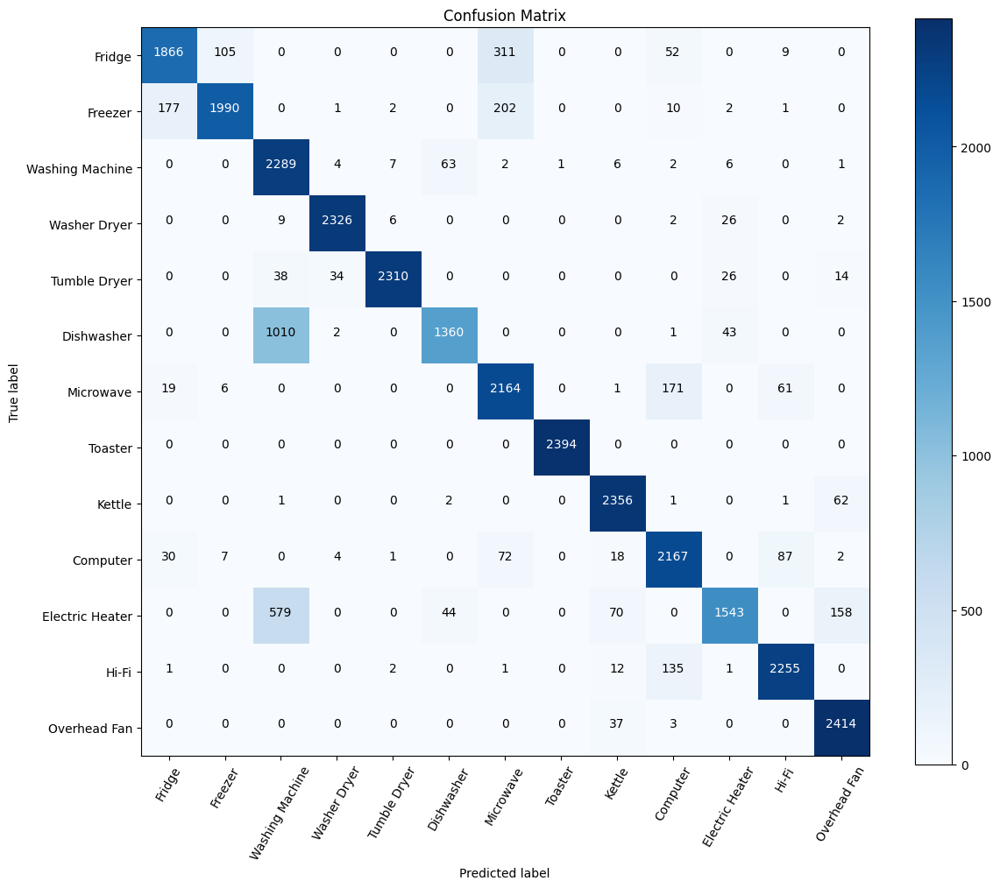

In [123]:
y_true = np.argmax(y_test, axis=1)
cm = confusion_matrix(y_true, probs)
plot_confusion_matrix(cm,classes = well_represented)

Finally, the last cell computes the various metrics used to verify the quality of the model.

In [124]:
from sklearn.metrics import classification_report 
print(classification_report(np.argmax(y_test, axis=-1), np.argmax(predictions, axis=-1),target_names=LABELS))

                 precision    recall  f1-score   support

       Computer       0.89      0.80      0.84      2343
     Dishwasher       0.94      0.83      0.89      2385
Electric Heater       0.58      0.96      0.73      2381
        Freezer       0.98      0.98      0.98      2371
         Fridge       0.99      0.95      0.97      2422
          Hi-Fi       0.93      0.56      0.70      2416
         Kettle       0.79      0.89      0.84      2422
      Microwave       1.00      1.00      1.00      2394
   Overhead Fan       0.94      0.97      0.96      2423
        Toaster       0.85      0.91      0.88      2388
   Tumble Dryer       0.94      0.64      0.76      2394
   Washer Dryer       0.93      0.94      0.94      2407
Washing Machine       0.91      0.98      0.95      2454

       accuracy                           0.88     31200
      macro avg       0.90      0.88      0.88     31200
   weighted avg       0.90      0.88      0.88     31200



Saving the model as it is. This will allow to rerun the exact model with the same weights and neurons, or to run inference by loading the moel later on.

In [ ]:
# from keras import ops
from keras.models import save_model

save_model(model,'./keras_models/GLU_CNN_LSTM_model.keras')
print('Saved model to: ./keras_models/GLU_CNN_LSTM_model.keras')


Saved model to: GLU_CNN_LSTM_model.keras


Loading the previous `GLU_CNN_LSTM_model.keras` model.

In [ ]:
from keras.models import load_model

loaded_model = load_model('./keras_models/GLU_CNN_LSTM_model.keras', custom_objects ={'relu6_div6': Activation(relu6_div6), 'Conv1DGLUBlock': Activation(Conv1DGLUBlock), 'ResidualBlock': Activation(ResidualBlock)})


## Second model: ON/OFF state classification per appliance on the aggregate signal

### Definition of the model

The next cell is used to create a custom loss class `FocalLoss` that helps deal with class imbalance with ON/OFF state. (To be run whenever loading a model from now on)

In [6]:
from keras.losses import Loss
from keras.saving import register_keras_serializable
import tensorflow as tf

@register_keras_serializable()
class FocalLoss(Loss):
    def __init__(self, gamma=2., alpha=0.25, **kwargs):
        super().__init__(**kwargs)
        self.gamma = gamma
        self.alpha = alpha

    def call(self, y_true, y_pred):
        bce = tf.keras.backend.binary_crossentropy(y_true, y_pred)
        pt = tf.exp(-bce)
        return self.alpha * tf.pow(1. - pt, self.gamma) * bce

    def get_config(self):
        config = super().get_config()
        config.update({
            "gamma": self.gamma,
            "alpha": self.alpha
        })
        return config

    @classmethod
    def from_config(cls, config):
        return cls(**config)


The next cell is used to generate the model

In [ ]:
from keras.metrics import BinaryAccuracy, AUC, Recall
from keras.layers import TimeDistributed, Dense, Bidirectional
from keras.optimizers import Adam

# Model Used for transfer learning for the aggregation task
def seq2seq_model(num_appliances):

    # loaded_model.summary()
    # for layer in loaded_model.layers[:8]:
    #     layer.trainable = False
    x = loaded_model.layers[-5].input

    seq2seq = ResidualBlock(filters=128, kernel_size=5)(x)
    seq2seq = MaxPooling1D(pool_size=1, strides=1)(seq2seq)

    # seq2seq = ResidualBlock(filters=256, kernel_size=5)(seq2seq)
    # seq2seq = MaxPooling1D(pool_size=1, strides=1)(seq2seq)

    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = MaxPooling1D(pool_size=1, strides=1)(seq2seq)

    seq2seq = Bidirectional(LSTM(64, return_sequences=True))(seq2seq)

    seq2seq = Dropout(0.2)(seq2seq)
    seq2seq = Bidirectional(LSTM(64, return_sequences=True))(seq2seq)
    seq2seq = TimeDistributed(Dense(128, activation='relu'))(seq2seq)
    seq2seq = Dropout(0.2)(seq2seq)


    seq2seq = Dense(num_appliances, activation='sigmoid')(seq2seq)
    # seq2seq = TimeDistributed(Dense(13, activation='sigmoid'), name="time_distributed_output")(x)

    import tensorflow as tf

    # Sort of a custom weighted binary crossentropy loss function
    # where we give more weight to positive samples (e.g., 5 times more)

    def weighted_binary_crossentropy(pos_weight=4.0):
        def loss_fn(y_true, y_pred):
            bce = tf.keras.backend.binary_crossentropy(y_true, y_pred)
            weights = 1.0 + pos_weight * y_true  # weight = 5 if y_true==1, else 1
            return tf.reduce_mean(bce * weights)
        return loss_fn

    loss = keras.losses.BinaryCrossentropy()
    weighted_loss = lambda y_true, y_pred: loss(y_true, y_pred) * (1 + 5*y_true)


    

    seq2seq_model = Model(inputs=loaded_model.input, outputs=seq2seq)
    seq2seq_model.compile(optimizer=Adam(learning_rate=0.0001), loss=FocalLoss(alpha=0.25), metrics=[BinaryAccuracy(name='binary_accuracy'),AUC(name='auc'), Recall(name='recall')])

    # # # Summary
    seq2seq_model.summary()
    return seq2seq_model

# import tensorflow as tf
# from keras.utils import get_custom_objects
# from keras.saving import register_keras_serializable
# @register_keras_serializable()
# def focal_loss(gamma=2., alpha=0.25):
#     def loss(y_true, y_pred):
#         bce = tf.keras.losses.binary_crossentropy(y_true, y_pred)
#         pt = tf.exp(-bce)
#         return alpha * (1 - pt) ** gamma * bce
#     return loss
# get_custom_objects().update({'focal_loss': focal_loss})



### Loading the data for the second model

The following cell loads the data for the appliances selected in `few_appliances`.

In [17]:
import os
import pandas as pd

few_appliances = ['Washer Dryer', 'Dishwasher', 'Kettle']
NUM_SEQUENCES = 5000
# Function to load appliance data from a directory structure
def load_appliance_data(root_dir,temp_appliance_data):
    appliance_data = {}

    for appliance in temp_appliance_data:
        appliance_dir = os.path.join(root_dir, appliance)
        if not os.path.isdir(appliance_dir):
            continue

        all_series = []

        for file in os.listdir(appliance_dir):
            print(f"Processing file: {file}")
            if file.endswith('.csv'):
                df = pd.read_csv(os.path.join(appliance_dir, file))

                power_col = appliance
                all_series.append(df[power_col].dropna().values)

        if all_series:
            appliance_data[appliance] = all_series

    print(f"Loaded data for {len(appliance_data)} appliances.")
    return appliance_data


The following cell is preprocessing the data to create a synthetic dataset used to train the second model. It returns `X` , `y` (for ON/OFF classification), `y_reg` (for regression used later), and `appliance_names`

In [18]:
import numpy as np
import random

def create_synthetic_dataset_from_csvs(
    appliance_data,
    sequence_length=512,
    num_sequences=1000,
    max_agg_power=8000,
    thresholds=None,
    max_attempts_per_seq=10
):
    if thresholds is None:
        thresholds = {
            'Washing Machine': 100,
            'Dishwasher': 100,
            'Kettle': 100,
        }

    appliance_names = list(appliance_data.keys())
    min_appliances_on = 1
    max_appliances_total = len(appliance_names) - 1
    min_on_ratio = 0.6

    synthetic_X = []
    synthetic_Y = []
    synthetic_Y_reg = []

    random.seed(62)
    np.random.seed(62)

    # Track how many times each appliance has been ON
    appliance_on_counts = {name: 0 for name in appliance_names}
    target_per_appliance = num_sequences // len(appliance_names)

    sequence_idx = 0
    while sequence_idx < num_sequences:
        print(f"Generating sequence {sequence_idx + 1}/{num_sequences}")

        # Choose one appliance that is underrepresented
        underrepresented = [a for a in appliance_names if appliance_on_counts[a] < target_per_appliance]
        if not underrepresented:
            break  # All appliances have hit target

        target_appliance = random.choice(underrepresented)

        # Ensure target appliance is included
        other_appliances = [a for a in appliance_names if a != target_appliance]
        random_appliances = random.sample(
            other_appliances,
            k=random.randint(min_appliances_on - 1, max_appliances_total - 1)
        )
        selected_appliances = [target_appliance] + random_appliances

        for attempt in range(max_attempts_per_seq):
            agg_seq = np.zeros(sequence_length)
            appliance_power_matrix = np.zeros((sequence_length, len(appliance_names)))
            on_appliance_count = 0
            success = False

            for appliance in selected_appliances:
                idx = appliance_names.index(appliance)
                csv_list = appliance_data[appliance]
                if not csv_list:
                    continue

                threshold = thresholds.get(appliance, 50)
                found_on_segment = False

                for _ in range(5):
                    series = random.choice(csv_list)
                    if len(series) < sequence_length:
                        series = np.pad(series, (0, sequence_length - len(series)))
                    else:
                        start = random.randint(0, len(series) - sequence_length)
                        series = series[start:start + sequence_length]

                    if (series > threshold).sum() >= sequence_length * min_on_ratio:
                        found_on_segment = True
                        break

                if not found_on_segment:
                    continue

                temp_agg = agg_seq + series
                if np.max(temp_agg) <= max_agg_power:
                    agg_seq = temp_agg
                    appliance_power_matrix[:, idx] = series
                    on_appliance_count += 1

            # Check if target appliance is ON
            target_idx = appliance_names.index(target_appliance)
            if appliance_power_matrix[:, target_idx].sum() > 0:
                appliance_on_counts[target_appliance] += 1
                success = True

            if success and on_appliance_count >= min_appliances_on:
                # Downsample ON/OFF labels
                label_vector = []
                label_vector_reg = []
                for i, appliance in enumerate(appliance_names):
                    threshold = thresholds.get(appliance, 50)
                    downsampled = appliance_power_matrix[:, i].reshape(-1, 4).mean(axis=1)
                    on_off = (downsampled > threshold).astype(int)
                    label_vector.append(on_off)
                    label_vector_reg.append(downsampled)

                label_matrix = np.stack(label_vector, axis=-1)
                label_matrix_reg = np.stack(label_vector_reg, axis=-1)
                synthetic_X.append(agg_seq.reshape(sequence_length, 1))
                synthetic_Y.append(label_matrix)
                synthetic_Y_reg.append(label_matrix_reg)
                sequence_idx += 1
                break  # Move to next sequence

    # Convert to arrays
    X = np.array(synthetic_X)
    y = np.array(synthetic_Y)
    y_reg = np.array(synthetic_Y_reg)

    # Shuffle the dataset
    idx = np.random.permutation(len(X))
    X = X[idx]
    y = y[idx]
    y_reg = y_reg[idx]

    return X, y, y_reg, appliance_names


In [19]:
few_appliances_data = load_appliance_data(DATA_DIR,few_appliances)


Processing file: Washer Dryer_House_1.csv_10.csv
Processing file: Washer Dryer_House_1.csv_117.csv
Processing file: Washer Dryer_House_1.csv_132.csv
Processing file: Washer Dryer_House_1.csv_134.csv
Processing file: Washer Dryer_House_1.csv_16.csv
Processing file: Washer Dryer_House_1.csv_26.csv
Processing file: Washer Dryer_House_1.csv_27.csv
Processing file: Washer Dryer_House_1.csv_34.csv
Processing file: Washer Dryer_House_1.csv_39.csv
Processing file: Washer Dryer_House_1.csv_40.csv
Processing file: Washer Dryer_House_1.csv_42.csv
Processing file: Washer Dryer_House_1.csv_44.csv
Processing file: Washer Dryer_House_1.csv_47.csv
Processing file: Washer Dryer_House_1.csv_49.csv
Processing file: Washer Dryer_House_1.csv_5.csv
Processing file: Washer Dryer_House_1.csv_50.csv
Processing file: Washer Dryer_House_1.csv_53.csv
Processing file: Washer Dryer_House_1.csv_54.csv
Processing file: Washer Dryer_House_1.csv_55.csv
Processing file: Washer Dryer_House_1.csv_56.csv
Processing file: W

Counting the number of zeros in the data to avoid to much class imbalance

In [9]:
# print(few_appliances_data)
count_0 = 0
count_other =0
for key,value in few_appliances_data.items():
    # print(value)
    print(f"{key}: {len(value)} series")
    for series in ((value)):
        # print(series)
        for i in series:
        # for i in range(len(series)):
            # print(i)
            if i == 0:
                count_0 += 1
            else:
                count_other += 1
print(f"Count of zeros in data: {count_0}")
print(f"Count of other values in data: {count_other}")


Washer Dryer: 139 series
Dishwasher: 860 series
Kettle: 63 series
Count of zeros in data: 27915
Count of other values in data: 1237244


In [20]:
# Create synthetic dataset
X, Y, y_reg, Labels = create_synthetic_dataset_from_csvs(few_appliances_data, sequence_length=300, num_sequences=40000)

print("X shape (aggregated):", X.shape)  # (30000, 300, 1)
print("Y shape (labels):", Y.shape)      # (30000, 300, num_appliances)
print("Appliance order:", Labels)

print("Example aggregated input (first sequence):", X[0])  
print("Example aggregated input (first sequence):", Y[0])  

Generating sequence 1/40000
Generating sequence 2/40000
Generating sequence 3/40000
Generating sequence 4/40000
Generating sequence 5/40000
Generating sequence 6/40000
Generating sequence 7/40000
Generating sequence 8/40000
Generating sequence 9/40000
Generating sequence 10/40000
Generating sequence 11/40000
Generating sequence 12/40000
Generating sequence 13/40000
Generating sequence 14/40000
Generating sequence 15/40000
Generating sequence 16/40000
Generating sequence 17/40000
Generating sequence 18/40000
Generating sequence 19/40000
Generating sequence 20/40000
Generating sequence 21/40000
Generating sequence 22/40000
Generating sequence 23/40000
Generating sequence 24/40000
Generating sequence 25/40000
Generating sequence 26/40000
Generating sequence 27/40000
Generating sequence 28/40000
Generating sequence 29/40000
Generating sequence 30/40000
Generating sequence 31/40000
Generating sequence 32/40000
Generating sequence 33/40000
Generating sequence 34/40000
Generating sequence 35/

### Plots pre-model training

Plotting the repartition of the data

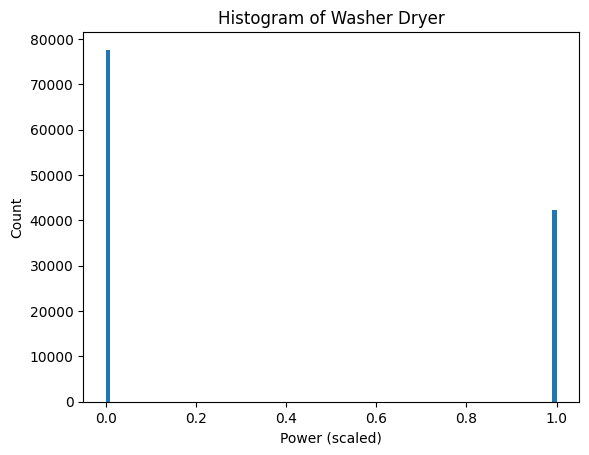

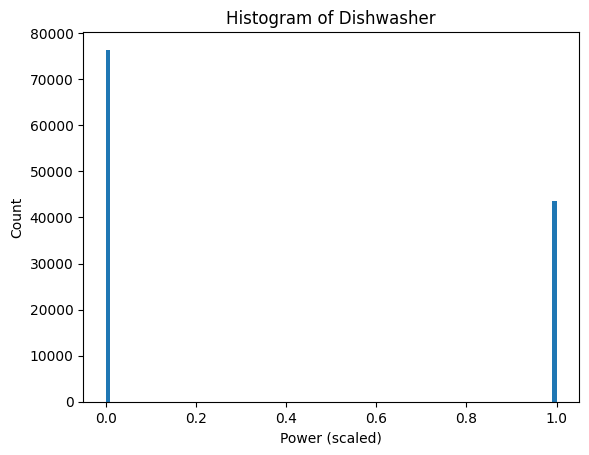

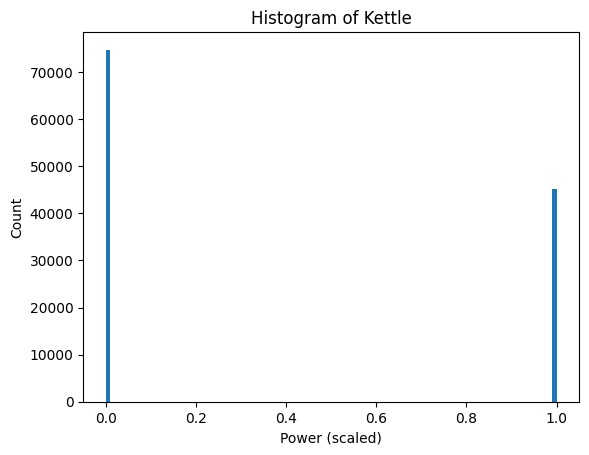

In [10]:
import matplotlib.pyplot as plt

for i, name in enumerate(few_appliances):
    plt.hist(Y[:, i].flatten(), bins=100)
    plt.title(f"Histogram of {name}")
    plt.xlabel('Power (scaled)')
    plt.ylabel('Count')
    plt.show()


Example of a synthetic aggregate signal with the associated appliances' ON/OFF time

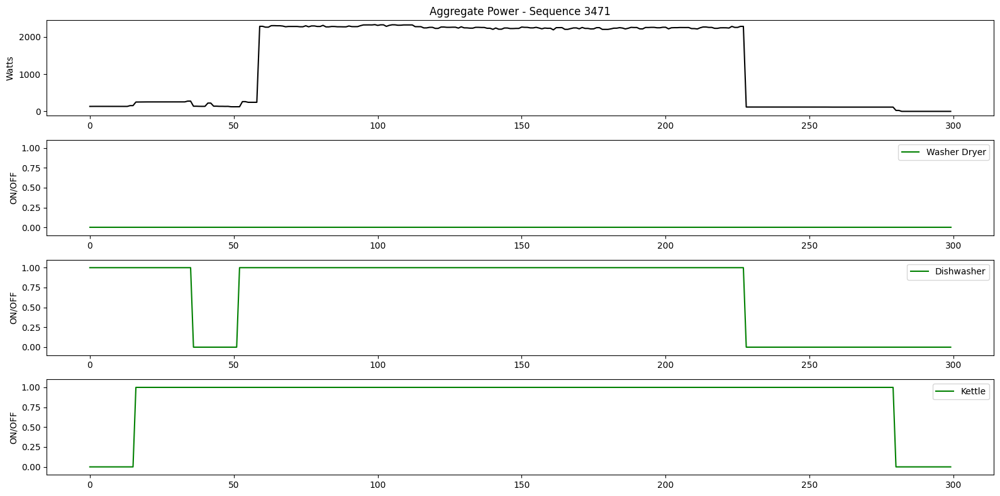

In [11]:
import matplotlib.pyplot as plt
import numpy as np

def plot_synthetic_examples(X, Y, appliance_names, num_examples=3):
    """
    Plot aggregate input signal and ON/OFF labels per appliance for a few sequences.

    Args:
        X (np.array): Shape (num_samples, sequence_length, 1)
        Y (np.array): Shape (num_samples, sequence_length_downsampled, num_appliances)
        appliance_names (List[str]): List of appliance names
        num_examples (int): Number of random examples to show
    """
    num_appliances = len(appliance_names)
    seq_len = X.shape[1]
    down_len = Y.shape[1]
    down_factor = seq_len // down_len

    indices = np.random.choice(len(X), size=num_examples, replace=False)

    for idx in indices:
        plt.figure(figsize=(16, 2 + 2 * num_appliances))
        
        # Plot aggregate power signal
        plt.subplot(num_appliances + 1, 1, 1)
        plt.plot(X[idx].squeeze(), color='black')
        plt.title(f'Aggregate Power - Sequence {idx}')
        plt.ylabel("Watts")

        # Plot each appliance ON/OFF label
        for i in range(num_appliances):
            plt.subplot(num_appliances + 1, 1, i + 2)
            plt.plot(np.repeat(Y[idx][:, i], down_factor), label=appliance_names[i], color='green')
            plt.ylabel("ON/OFF")
            plt.ylim(-0.1, 1.1)
            plt.legend(loc="upper right")

        plt.tight_layout()
        plt.show()

appliance_names = [
    'Fridge', 'Washer Dryer', 'Washing Machine', 'Dishwasher']

plot_synthetic_examples(X, Y, few_appliances, num_examples=1)



### Second model

`reduce_lr` is used when the model starts to plateau during training

In [136]:
from keras.callbacks import ReduceLROnPlateau, EarlyStopping

reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',   # What to track
    factor=0.5,           # Reduce LR by this factor
    patience=3,           # Wait this many epochs with no improvement
    min_lr=1e-6,          # Minimum LR to avoid going too low
    verbose=1             # Print updates
)

early_stopping = EarlyStopping(
    monitor='val_loss',   # What to track
    patience=5,           # Wait this many epochs with no improvement
    restore_best_weights=True,  # Restore best weights after stopping
    verbose=1             # Print updates
    )


Comparing class imbalance

In [13]:

# Show the class imbalance in the dataset
def imbalance_calc (y, dataset,temp_appliance_data):
    y_flat = y.reshape(-1, y.shape[-1])
    on_percentage = 100 * np.mean(y_flat, axis=0)
    off_percentage = 100 - on_percentage
    on_off_df = pd.DataFrame({
        f'Appliance in {dataset}': [f'{temp_appliance_data[i]}' for i in range(y.shape[-1])],
        'ON (%)': on_percentage,
        'OFF (%)': off_percentage
    })
    print(on_off_df)

imbalance_calc(Y,'Dataset', few_appliances)



  Appliance in Dataset     ON (%)    OFF (%)
0         Washer Dryer  47.470820  52.529180
1           Dishwasher  36.448445  63.551555
2               Kettle  46.550097  53.449903


The following cell starts the training of the second model over **20 epochs** using **batches of size 64**.

In [17]:
print(f"Generated {len(X)} sequences with shape {X.shape} and labels shape {Y.shape}")
few_appliances_model = seq2seq_model(len(few_appliances))
history = few_appliances_model.fit(X, Y, epochs=20, batch_size=64, validation_split=0.1, callbacks=[reduce_lr])

Generated 39999 sequences with shape (39999, 300, 1) and labels shape (39999, 75, 3)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_13      │ (None, 300, 1)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_159 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_158 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_73       │ (None, 300, 64)   │          0 │ conv1d_159[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_44         │ (None, 300, 64)   │          0 │ conv1d_158[0][0], │
│ (Multiply)          │                   │            │ activation_73[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_161 (Conv1D) │ (None, 300, 64)   │        128 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_160 (Conv1D) │ (None, 300, 64)   │      4,160 │ multiply_44[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_44 (Add)        │ (None, 300, 64)   │          0 │ conv1d_161[0][0], │
│                     │                   │            │ conv1d_160[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_44    │ (None, 150, 64)   │          0 │ add_44[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_163 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_162 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_74       │ (None, 150, 128)  │          0 │ conv1d_163[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_45         │ (None, 150, 128)  │          0 │ conv1d_162[0][0], │
│ (Multiply)          │                   │            │ activation_74[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_165 (Conv1D) │ (None, 150, 128)  │      8,320 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_164 (Conv1D) │ (None, 150, 128)  │     16,512 │ multiply_45[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_45 (Add)        │ (None, 150, 128)  │          0 │ conv1d_165[0][0], │
│                     │                   │            │ conv1d_164[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_45    │ (None, 75, 128)   │          0 │ add_45[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_1 (Conv1D)   │ (None, 75, 128)   │     82,048 │ max_pooling1d_45… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d (Conv1D)     │ (None, 75, 128)   │     82,048 │ max_pooling1d_45… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 75, 128)   │          0 │ conv1d_1[0][0]    │
│ (Activation)        │                   │            │                 

 Total params: 589,507 (2.25 MB)

 Trainable params: 589,507 (2.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


KeyboardInterrupt: 

Running predictions over the training dataset. 

In [118]:
# Predict on train data
print(X.shape)
heavy_train_preds = few_appliances_model.predict(X.squeeze(axis=-1), verbose=1)

# Threshold predictions to 0/1 
heavy_preds_train_binary = (heavy_train_preds > 0.5).astype(int)


(39999, 300, 1)
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 50s 39ms/step


Computing the metrics for each class

In [119]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

num_appliances = heavy_preds_train_binary.shape[2]
per_appliance_acc_train = []
# Print accuracy, precision, recall, and F1 score for each appliance
for i in range(num_appliances):
    y_true = Y[:, :, i].flatten()
    y_pred = heavy_preds_train_binary[:, :, i].flatten()
    
    acc = accuracy_score(y_true, y_pred)
    per_appliance_acc_train.append(acc)

    acc = accuracy_score(y_true, y_pred)
    prec = precision_score(y_true, y_pred, zero_division=0)
    rec = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)

    print(f"{few_appliances[i]} - Train Acc: {acc:.4f} | Prec: {prec:.4f} | Rec: {rec:.4f} | F1: {f1:.4f}")


Washer Dryer - Train Acc: 0.8818 | Prec: 0.9228 | Rec: 0.8129 | F1: 0.8643
Dishwasher - Train Acc: 0.8598 | Prec: 0.8657 | Rec: 0.7276 | F1: 0.7906
Kettle - Train Acc: 0.7676 | Prec: 0.7622 | Rec: 0.5981 | F1: 0.6703


### Plots post-model training

Plotting the predicted ON/OFF time vs the truth for each appliance

In [94]:
import matplotlib.pyplot as plt
import numpy as np

def plot_gt_vs_prediction_lines(agg_signal, true_labels, pred_labels, appliance_names, sample_idx=0):
    """
    Plots aggregate signal and ON segments as dashed lines (--) for each appliance.
    Separate plots for ground truth and predictions.

    Parameters:
    - agg_signal: (sequence_length,) array
    - true_labels: (sequence_length // 4, num_appliances)
    - pred_labels: same shape
    - appliance_names: list of appliance names
    - sample_idx: index for labeling
    """
    num_appliances = true_labels.shape[1]
    sequence_length = len(agg_signal)
    downsample_factor = sequence_length // true_labels.shape[0]
    time_axis = np.arange(sequence_length)

    fig, axs = plt.subplots(3, 1, figsize=(16, 8), sharex=True,
                            gridspec_kw={'height_ratios': [1.5, 1, 1]})

    # Plot aggregate power
    axs[0].plot(time_axis, agg_signal, color='black', linewidth=1.5)
    axs[0].set_title("Aggregate Power")
    axs[0].set_ylabel("Power (W)")
    axs[0].grid(True)

    # Plot Ground Truth
    for i in range(num_appliances):
        y_pos = i  # vertical position for the appliance line
        for t in range(true_labels.shape[0]):
            if true_labels[t, i] == 1:
                start = t * downsample_factor
                end = (t + 1) * downsample_factor
                axs[1].hlines(y=y_pos, xmin=start, xmax=end, colors='green', linestyles='--', linewidth=2)

    axs[1].set_yticks(range(num_appliances))
    axs[1].set_yticklabels(appliance_names)
    axs[1].set_title("Ground Truth Appliance Activations")
    axs[1].grid(True)

    # Plot Predictions
    for i in range(num_appliances):
        y_pos = i
        for t in range(pred_labels.shape[0]):
            if pred_labels[t, i] == 1:
                start = t * downsample_factor
                end = (t + 1) * downsample_factor
                axs[2].hlines(y=y_pos, xmin=start, xmax=end, colors='blue', linestyles='--', linewidth=2)

    axs[2].set_yticks(range(num_appliances))
    axs[2].set_yticklabels(appliance_names)
    axs[2].set_title("Predicted Appliance Activations")
    axs[2].set_xlabel("Time Steps")
    axs[2].grid(True)

    plt.tight_layout()
    plt.suptitle(f"Sample {sample_idx}: Ground Truth vs Prediction", fontsize=16, y=1.02)
    plt.show()


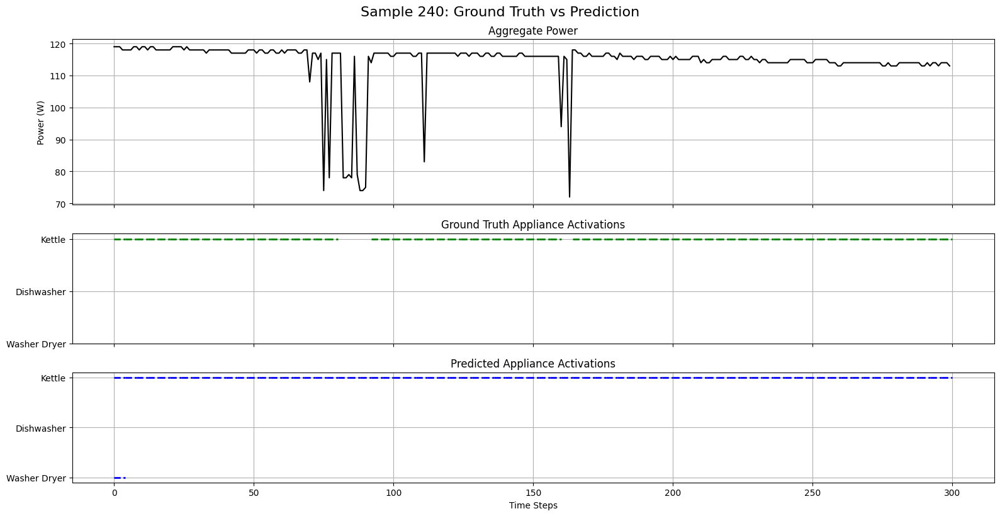

In [134]:
sample_idx = 240

agg_signal = X[sample_idx].squeeze()
true_labels = Y[sample_idx]
pred_labels = heavy_preds_train_binary[sample_idx]  # shape: (128, num_appliances)

plot_gt_vs_prediction_lines(agg_signal, true_labels, pred_labels, few_appliances, sample_idx)


Comparing the validation metrics and the training metrics to make sure no overfitting is happening

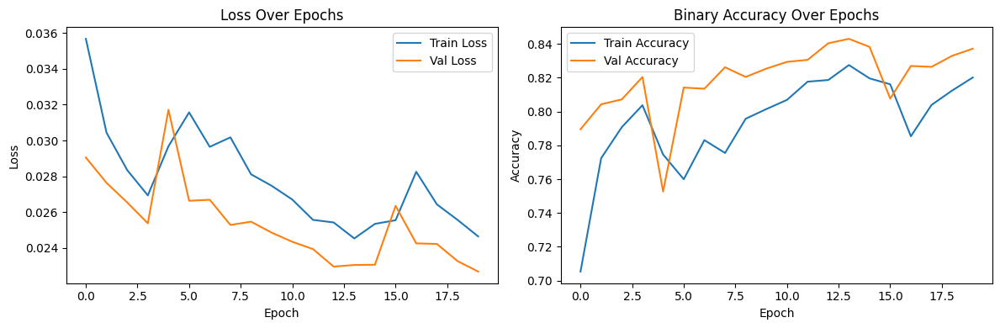

In [135]:
import matplotlib.pyplot as plt

# Plot training & validation loss
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# Plot training & validation accuracy
plt.subplot(1, 2, 2)
plt.plot(history.history['binary_accuracy'], label='Train Accuracy')
plt.plot(history.history['val_binary_accuracy'], label='Val Accuracy')
plt.title('Binary Accuracy Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()


### Generation and prediction of the testing class

The following cell loads and preprocesses the real-life data used for testing

In [156]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# PARAMETERS
WINDOW_SIZE = 300
STRIDE = 150
TARGET_COLUMNS = ['Fridge', 'Washer Dryer', 'Washing Machine', 'Dishwasher',
                  'Television', 'Hi-Fi','Microwave', 'Kettle', 'Electric Heater']
AGG_COLUMN = 'Aggregate'
UNIX_COLUMN = 'Unix'
NUM_SAMPLES = 10000

# Load CSV
df = pd.read_csv(f'{DATA_DIR}/House_9.csv')

# Drop unnecessary columns (keep only aggregate + target appliances)
df = df[[AGG_COLUMN, *TARGET_COLUMNS, UNIX_COLUMN]]


# Function to create windowed sequences
def create_sequences(data, target_appliances= TARGET_COLUMNS, appliances_to_remove = [],window_size=300, stride=150):
    count = 0
    X = []
    y = []

    # Get column indices
    agg_idx = data.columns.get_loc(AGG_COLUMN)

    remove_idxs = [data.columns.get_loc(col) for col in appliances_to_remove]
    
    new_data = data.drop(columns=appliances_to_remove, errors='ignore')
    target_appliances = [col for col in target_appliances if col not in appliances_to_remove]
    target_idxs = [new_data.columns.get_loc(col) for col in target_appliances]
    for i in range(0, len(new_data) - window_size, stride):
        if count >= NUM_SAMPLES:
            break

        window = new_data.iloc[i:i + window_size].fillna(0).values.astype(np.float32)
        for_data_removal = data.iloc[i:i + window_size].fillna(0).values.astype(np.float32)


        # Aggregate signal (1D input)
        agg_window = np.copy(window[:, agg_idx])
        print(window.shape)
        print(agg_window.shape)
        for idx in remove_idxs:

            agg_window -= for_data_removal[:, idx]

        # Aggregate signal (1D input)

        X.append(agg_window)  # shape: (300, 1)

        # Extract target appliance usage
        target_data = window[:, target_idxs]  # shape: (300, num_appliances)

        # Downsample to 75 by averaging every 4 rows
        chunks = np.split(target_data[:300], 75)  # 300/4 = 75
        
        combined_chunks = np.array([
        chunk.min(axis=0)  # min across 4 samples → shape: (9,)
        for chunk in chunks
        ])  # shape: (75, 9)
        
        y.append(combined_chunks)

        count += 1
        print(count)

    y = np.array(y)

# Apply threshold after conversion to NumPy array
    y_class = (y > 10).astype(int)

    return np.array(X), np.array(y_class), np.array(y)

X_test, y_test, y_test_regression = create_sequences(df,appliances_to_remove=['Fridge','Washer Dryer','Microwave','Electric Heater','Television','Hi-Fi'], window_size=WINDOW_SIZE, stride=STRIDE)


(300, 5)
(300,)
1
(300, 5)
(300,)
2
(300, 5)
(300,)
3
(300, 5)
(300,)
4
(300, 5)
(300,)
5
(300, 5)
(300,)
6
(300, 5)
(300,)
7
(300, 5)
(300,)
8
(300, 5)
(300,)
9
(300, 5)
(300,)
10
(300, 5)
(300,)
11
(300, 5)
(300,)
12
(300, 5)
(300,)
13
(300, 5)
(300,)
14
(300, 5)
(300,)
15
(300, 5)
(300,)
16
(300, 5)
(300,)
17
(300, 5)
(300,)
18
(300, 5)
(300,)
19
(300, 5)
(300,)
20
(300, 5)
(300,)
21
(300, 5)
(300,)
22
(300, 5)
(300,)
23
(300, 5)
(300,)
24
(300, 5)
(300,)
25
(300, 5)
(300,)
26
(300, 5)
(300,)
27
(300, 5)
(300,)
28
(300, 5)
(300,)
29
(300, 5)
(300,)
30
(300, 5)
(300,)
31
(300, 5)
(300,)
32
(300, 5)
(300,)
33
(300, 5)
(300,)
34
(300, 5)
(300,)
35
(300, 5)
(300,)
36
(300, 5)
(300,)
37
(300, 5)
(300,)
38
(300, 5)
(300,)
39
(300, 5)
(300,)
40
(300, 5)
(300,)
41
(300, 5)
(300,)
42
(300, 5)
(300,)
43
(300, 5)
(300,)
44
(300, 5)
(300,)
45
(300, 5)
(300,)
46
(300, 5)
(300,)
47
(300, 5)
(300,)
48
(300, 5)
(300,)
49
(300, 5)
(300,)
50
(300, 5)
(300,)
51
(300, 5)
(300,)
52
(300, 5)
(300,)
53
(3

In [ ]:
print(f"X_test shape: {X_test.shape}")  # Should be (num_samples, 300)

X_test shape: (10000, 300)


Predicting on the testing dataset.

In [137]:
# Predict on test data
few_appliances_preds = few_appliances_model.predict(X_test)

# Threshold predictions to 0/1 (optional: use different threshold)
few_appliances_preds_binary = (few_appliances_preds > 0.5).astype(int)


313/313 ━━━━━━━━━━━━━━━━━━━━ 10s 33ms/step


Computing metrics for the testing dataset.

In [28]:
from sklearn.metrics import accuracy_score, recall_score, f1_score, precision_score, recall_score
from sklearn.metrics import accuracy_score

# y_test and preds_binary shape: (num_samples, num_appliances)

# Overall accuracy (flatten all)
def flatten_and_compare(Y, Y_pred, appliance_names):
    num_appliances = len(appliance_names)
    per_appliance_acc_train = []
    # Print accuracy, precision, recall, and F1 score for each appliance
    for i in range(num_appliances):
        y_true = Y[:, :, i].flatten()
        y_pred = Y_pred[:, :, i].flatten()
        
        acc = accuracy_score(y_true, y_pred)
        per_appliance_acc_train.append(acc)

        acc = accuracy_score(y_true, y_pred)
        prec = precision_score(y_true, y_pred, zero_division=0)
        rec = recall_score(y_true, y_pred, zero_division=0)
        f1 = f1_score(y_true, y_pred, zero_division=0)

        print(f"{appliance_names[i]} - Test Acc: {acc:.4f} | Prec: {prec:.4f} | Rec: {rec:.4f} | F1: {f1:.4f}")

print('Appliance Test Results:')
flatten_and_compare(y_test, few_appliances_preds_binary, few_appliances)
# print('Light Appliance Test Results:')
# flatten_and_compare(y_test_l, light_preds_binary, light_burst_appliance)

Appliance Test Results:


NameError: name 'few_appliances_preds_binary' is not defined

Saving the model and loading the model.

In [ ]:
# from keras import ops
from keras.models import save_model

save_model(few_appliances_model,'./keras_models/few_appliances_seq2seq_model.keras')
print('Saved model to: ./keras_models/few_appliances_seq2seq_model.keras')


Saved model to: few_appliances_seq2seq_model.keras


In [ ]:
from keras.models import load_model

classification_few_appliances_loaded_model = load_model('./keras_models/few_appliances_seq2seq_model.keras', custom_objects={
    'relu6_div6': (relu6_div6),
    'Conv1DGLUBlock': (Conv1DGLUBlock),
    'ResidualBlock': (ResidualBlock),
    })


In [91]:
loaded_heavy_preds = classification_few_appliances_loaded_model.predict(X)

# Threshold predictions to 0/1 (optional: use different threshold)
loaded_heavy_preds_binary = (loaded_heavy_preds > 0.5).astype(int)

print('Heavy Appliance Test Results:')
flatten_and_compare(Y, loaded_heavy_preds_binary, few_appliances)

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step
Heavy Appliance Test Results:
Washer Dryer - Test Acc: 0.8772 | Prec: 0.9122 | Rec: 0.8203 | F1: 0.8638
Dishwasher - Test Acc: 0.8487 | Prec: 0.8537 | Rec: 0.7058 | F1: 0.7727
Kettle - Test Acc: 0.7207 | Prec: 0.7951 | Rec: 0.5389 | F1: 0.6424


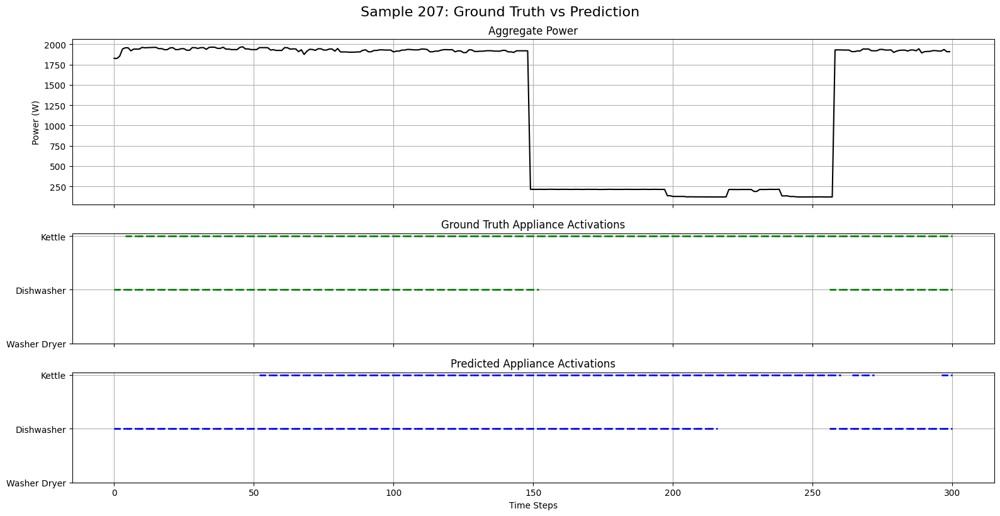

In [171]:
sample_idx = 207

agg_signal = X[sample_idx].squeeze()
true_labels = Y[sample_idx]
pred_labels = loaded_heavy_preds_binary[sample_idx]  # shape: (128, num_appliances)

plot_gt_vs_prediction_lines(agg_signal, true_labels, pred_labels, few_appliances, sample_idx)

## Third model: Regression on power consumption per appliance on the aggregate signal

The next cell generates the third model used for the regression.

### Defining the third model

In [26]:
from keras.losses import MeanAbsoluteError, MeanSquaredError, Huber
from keras.optimizers import Adam
from keras.activations import leaky_relu

def build_seq2seq_regression(loaded_model, num_classes=4):

# loaded_model.summary()
    # for layer in loaded_model.layers[:8]:
    #     layer.trainable = False
    x = loaded_model.layers[-3].input

    seq2seq = ResidualBlock(filters=256, kernel_size=7)(x)
    seq2seq = MaxPooling1D(pool_size=1, strides=1)(seq2seq)
    # print(f"Shape of second-last layer output: {x.shape}")
    
    seq2seq = ResidualBlock(filters=64, kernel_size=3)(seq2seq)
    seq2seq = MaxPooling1D(pool_size=1, strides=1)(seq2seq)
    # seq2seq = ResidualBlock(filters=128, kernel_size=5)(seq2seq)
    # seq2seq = MaxPooling1D(pool_size=1, strides=1)(seq2seq)

    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = MaxPooling1D(pool_size=1, strides=1)(seq2seq)
    seq2seq = LSTM(64, return_sequences=True)(seq2seq)
    # seq2seq = TimeDistributed(Dense(13, activation='sigmoid'), name="time_distributed_output")(seq2seq)
    # Compile

    seq2seq = Dense(num_classes, activation='relu')(seq2seq)
    # seq2seq = TimeDistributed(Dense(13, activation='sigmoid'), name="time_distributed_output")(x)


    seq2seq_model = Model(inputs=loaded_model.input, outputs=seq2seq)
    seq2seq_model.compile(optimizer=Adam(learning_rate=0.0001), loss="mae", metrics=[MeanAbsoluteError(), MeanSquaredError()])

    # # # Summary
    seq2seq_model.summary()
    return seq2seq_model

### Pre-training plots

Plotting the logarithmic repartition of the power consumption values.

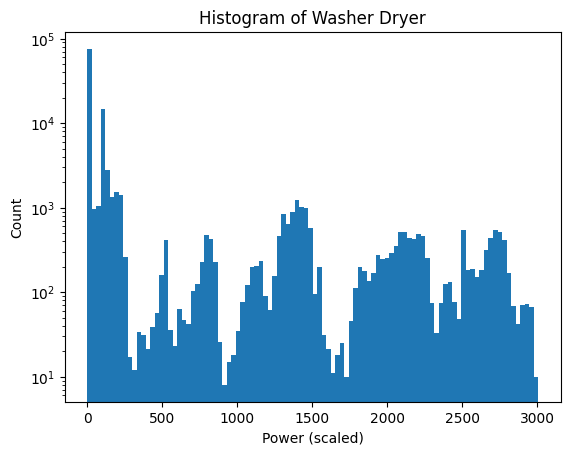

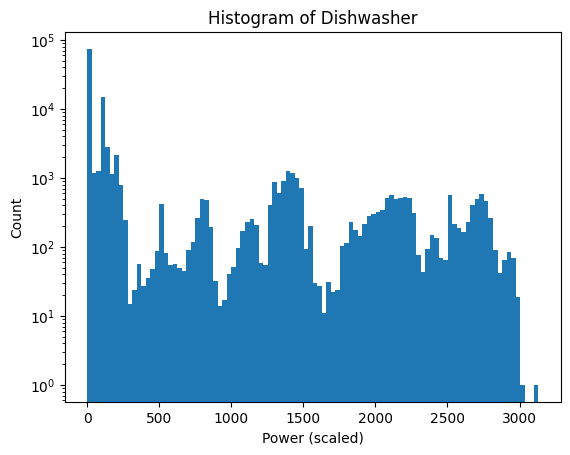

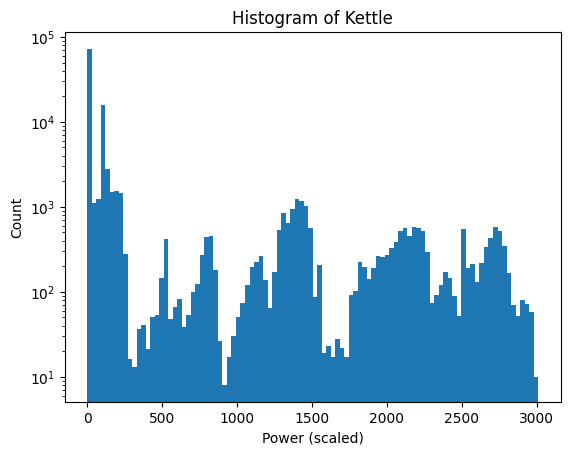

In [85]:
import matplotlib.pyplot as plt

for i, name in enumerate(few_appliances):
    plt.hist(y_reg[:, i].flatten(), bins=100, log=True)
    plt.title(f"Histogram of {name}")
    plt.xlabel('Power (scaled)')
    plt.ylabel('Count')
    plt.show()


### Training the third model

This cell is used to scale the data used between 0 and 1.

In [196]:
from sklearn.preprocessing import MinMaxScaler

scaler_Y = MinMaxScaler()
# y_total = np.concatenate([y_h_reg, y_l_reg], axis=-1)  # shape: (samples, 7)
Y_scaled = scaler_Y.fit_transform(y_reg.reshape(-1, y_reg.shape[-1])).reshape(y_reg.shape)


The following cell starts the training of the second model over **15 epochs** using **batches of size 64**.

In [32]:
print(f"Generated {len(X)} sequences with shape {X.shape} and labels shape {Y.shape}")
regression_model = build_seq2seq_regression(classification_few_appliances_loaded_model, len(few_appliances))
history1 = regression_model.fit(X, Y_scaled, epochs=15, batch_size=64, validation_split=0.1)

Generated 39999 sequences with shape (39999, 300, 1) and labels shape (39999, 75, 3)


Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_13      │ (None, 300, 1)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_159 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_158 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_73       │ (None, 300, 64)   │          0 │ conv1d_159[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_44         │ (None, 300, 64)   │          0 │ conv1d_158[0][0], │
│ (Multiply)          │                   │            │ activation_73[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_161 (Conv1D) │ (None, 300, 64)   │        128 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_160 (Conv1D) │ (None, 300, 64)   │      4,160 │ multiply_44[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_44 (Add)        │ (None, 300, 64)   │          0 │ conv1d_161[0][0], │
│                     │                   │            │ conv1d_160[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_44    │ (None, 150, 64)   │          0 │ add_44[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_163 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_162 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_74       │ (None, 150, 128)  │          0 │ conv1d_163[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_45         │ (None, 150, 128)  │          0 │ conv1d_162[0][0], │
│ (Multiply)          │                   │            │ activation_74[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_165 (Conv1D) │ (None, 150, 128)  │      8,320 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_164 (Conv1D) │ (None, 150, 128)  │     16,512 │ multiply_45[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_45 (Add)        │ (None, 150, 128)  │          0 │ conv1d_165[0][0], │
│                     │                   │            │ conv1d_164[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_45    │ (None, 75, 128)   │          0 │ add_45[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_42 (Conv1D)  │ (None, 75, 128)   │     82,048 │ max_pooling1d_45… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_41 (Conv1D)  │ (None, 75, 128)   │     82,048 │ max_pooling1d_45… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_16       │ (None, 75, 128)   │          0 │ conv1d_42[0][0]   │
│ (Activation)        │                   │            │                 

 Total params: 2,157,699 (8.23 MB)

 Trainable params: 2,157,699 (8.23 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 216s 356ms/step - loss: 0.2926 - mean_absolute_error: 0.2926 - mean_squared_error: 0.2339 - val_loss: 0.2382 - val_mean_absolute_error: 0.2382 - val_mean_squared_error: 0.2036
Epoch 2/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 216s 384ms/step - loss: 0.2588 - mean_absolute_error: 0.2588 - mean_squared_error: 0.2136 - val_loss: 0.2220 - val_mean_absolute_error: 0.2224 - val_mean_squared_error: 0.2011
Epoch 3/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 221s 392ms/step - loss: 0.2382 - mean_absolute_error: 0.2382 - mean_squared_error: 0.2045 - val_loss: 0.2443 - val_mean_absolute_error: 0.2440 - val_mean_squared_error: 0.1990
Epoch 4/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 215s 381ms/step - loss: 0.2380 - mean_absolute_error: 0.2380 - mean_squared_error: 0.2058 - val_loss: 0.2008 - val_mean_absolute_error: 0.2011 - val_mean_squared_error: 0.1837
Epoch 5/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 215s 382ms/step - loss: 0.2432 - mean_absolute_error: 0.2432 - mean_squared_error: 0.2153 - val_

### Loading and predicting the testing dataset

The following cell loads and generates the testing dataset for the regression.

In [155]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# PARAMETERS
WINDOW_SIZE = 300
STRIDE = 150
TARGET_COLUMNS = ['Fridge', 'Washer Dryer', 'Washing Machine', 'Dishwasher',
                  'Television', 'Hi-Fi','Microwave', 'Kettle', 'Electric Heater']
AGG_COLUMN = 'Aggregate'
UNIX_COLUMN = 'Unix'
NUM_SAMPLES = 10000

# Load CSV
# df = pd.read_csv(f'{DATA_DIR}/House_9.csv')
chunk_iter = pd.read_csv(f'{DATA_DIR}/House_9.csv', chunksize=500000)  # adjust size if needed
df_list = []
for chunk in chunk_iter:
    chunk = chunk[[AGG_COLUMN, *TARGET_COLUMNS, UNIX_COLUMN]]
    df_list.append(chunk)
    if sum(len(df) for df in df_list) >= NUM_SAMPLES * STRIDE:  # Stop early
        break

df = pd.concat(df_list, ignore_index=True)

# Drop unnecessary columns (keep only aggregate + target appliances)
df = df[[AGG_COLUMN, *TARGET_COLUMNS, UNIX_COLUMN]]


# Function to create windowed sequences
def create_sequences(data, target_appliances= TARGET_COLUMNS, appliances_to_remove = [],window_size=300, stride=150):
    count = 0
    X = []
    y = []

    # Get column indices
    agg_idx = data.columns.get_loc(AGG_COLUMN)

    remove_idxs = [data.columns.get_loc(col) for col in appliances_to_remove]
    
    new_data = data.drop(columns=appliances_to_remove, errors='ignore')
    target_appliances = [col for col in target_appliances if col not in appliances_to_remove]
    target_idxs = [new_data.columns.get_loc(col) for col in target_appliances]
    for i in range(0, len(new_data) - window_size, stride):
        if count >= NUM_SAMPLES:
            break

        window = new_data.iloc[i:i + window_size].fillna(0).values.astype(np.float32)
        for_data_removal = data.iloc[i:i + window_size].fillna(0).values.astype(np.float32)


        # Aggregate signal (1D input)
        agg_window = np.copy(window[:, agg_idx])
        # print(window.shape)
        # print(agg_window.shape)
        for idx in remove_idxs:

            agg_window -= for_data_removal[:, idx]

        # Aggregate signal (1D input)

        X.append(agg_window)  # shape: (300, 1)

        # Extract target appliance usage
        target_data = window[:, target_idxs]  # shape: (300, num_appliances)

        # Downsample to 75 by averaging every 4 rows
        chunks = np.split(target_data[:300], 75)  # 300/4 = 75
        
        combined_chunks = np.array([
        chunk.min(axis=0)  # min across 4 samples → shape: (9,)
        for chunk in chunks
        ])  # shape: (75, 9)
        
        y.append(combined_chunks)
        # print(combined_chunks)
        count += 1
        # print(count)

    y = np.array(y)
    
    X = np.array(X)
    if X.ndim == 2:
        X = X.reshape((X.shape[0], X.shape[1], 1))

    for i in range(len(X)):
        for j in range(y.shape[1]):
            if y[i, j].sum() != X[i, 4*j : 4*(j+1), 0].min():
                print(f"Mismatch at index {i}, position {j}: X={X[i][j]}, y={y[i][j].sum()}")
                X[i, 4*j : 4*(j+1), 0] = y[i, j].sum()
                

# Apply threshold after conversion to NumPy array
    y_class = (y > 10).astype(int)

    return np.array(X), np.array(y), np.array(y_class), target_appliances

X_test, y_test, y_test_class, labels_test = create_sequences(df,appliances_to_remove=['Fridge','Washing Machine','Microwave','Electric Heater','Television','Hi-Fi'], window_size=WINDOW_SIZE, stride=STRIDE)

Mismatch at index 0, position 0: X=[193.], y=0.0
Mismatch at index 0, position 1: X=[0.], y=0.0
Mismatch at index 0, position 2: X=[0.], y=0.0
Mismatch at index 0, position 3: X=[0.], y=0.0
Mismatch at index 0, position 4: X=[0.], y=0.0
Mismatch at index 0, position 5: X=[0.], y=0.0
Mismatch at index 0, position 6: X=[0.], y=0.0
Mismatch at index 0, position 7: X=[0.], y=0.0
Mismatch at index 0, position 8: X=[0.], y=0.0
Mismatch at index 0, position 9: X=[0.], y=0.0
Mismatch at index 0, position 10: X=[0.], y=0.0
Mismatch at index 0, position 11: X=[0.], y=0.0
Mismatch at index 0, position 12: X=[0.], y=0.0
Mismatch at index 0, position 13: X=[0.], y=0.0
Mismatch at index 0, position 14: X=[0.], y=0.0
Mismatch at index 0, position 15: X=[0.], y=0.0
Mismatch at index 0, position 16: X=[0.], y=0.0
Mismatch at index 0, position 17: X=[0.], y=0.0
Mismatch at index 0, position 18: X=[0.], y=0.0
Mismatch at index 0, position 19: X=[0.], y=0.0
Mismatch at index 0, position 20: X=[0.], y=0.0


KeyboardInterrupt: 

Scaling the testing dateset

In [195]:
from sklearn.preprocessing import MinMaxScaler

scaler_y_test = MinMaxScaler()
# y_total = np.concatenate([y_h_reg, y_l_reg], axis=-1)  # shape: (samples, 7)
Y_test_scaled = scaler_y_test.fit_transform(y_test.reshape(-1, y_test.shape[-1])).reshape(y_test.shape)
# Y_test_scaled_classification = scaler_y.fit_transform(y_test_class.reshape(-1, y_test_class.shape[-1])).reshape(y_test_class.shape)

In [70]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def flatten_time_dimension(y_test, Y_pred, appliance):
    if y_test.ndim == 3:
        y_test_flat = y_test.reshape(-1, y_test.shape[-1])  # (samples * timesteps, num_appliances)
        preds_flat = Y_pred.reshape(-1, Y_pred.shape[-1])
    else:
        y_test_flat = y_test
        preds_flat = Y_pred

    # Option 1: Overall metrics (across all appliances and all samples)
    mae = mean_absolute_error(y_test_flat, preds_flat)
    mse = mean_squared_error(y_test_flat, preds_flat)
    r2 = r2_score(y_test_flat, preds_flat)

    print(f"\n📊 Overall Test MAE: {mae:.2f}")
    print(f"📉 Overall Test MSE: {mse:.2f}")
    print(f"📈 Overall R² Score: {r2:.4f}")

    # Option 2: Per-appliance metrics
    print("\n🔍 Per-Appliance Regression Metrics:")
    print(appliance)

    num_appliances = min(y_test_flat.shape[1], len(appliance))

    for i in range(num_appliances):
        mae_i = mean_absolute_error(y_test_flat[:, i], preds_flat[:, i])
        mse_i = mean_squared_error(y_test_flat[:, i], preds_flat[:, i])
        r2_i = r2_score(y_test_flat[:, i], preds_flat[:, i])

        print(f"{appliance[i]}:")
        print(f"  MAE: {mae_i:.2f} | MSE: {mse_i:.2f} | R²: {r2_i:.4f}")


# flatten_time_dimension(y_test_l, Y_pred_l, low_power_data)

Computing metrics for synthetic dataset and real-life dataset

In [33]:
preds_regression = regression_model.predict(X)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (preds_regression > 0.5).astype(int)

print('Heavy Appliance Test Results:')
flatten_time_dimension(Y_scaled, preds_regression, few_appliances)

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 100s 79ms/step
Heavy Appliance Test Results:

📊 Overall Test MAE: 0.19
📉 Overall Test MSE: 0.18
📈 Overall R² Score: 0.2755

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.17 | MSE: 0.15 | R²: 0.3831
Dishwasher:
  MAE: 0.16 | MSE: 0.14 | R²: 0.3932
Kettle:
  MAE: 0.26 | MSE: 0.24 | R²: 0.0502


In [180]:
preds_regression_test = regression_model.predict(X_test)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (preds_regression > 0.5).astype(int)

print('Heavy Appliance Test Results:')
flatten_time_dimension(Y_test_scaled, preds_regression_test, few_appliances)

313/313 ━━━━━━━━━━━━━━━━━━━━ 39s 124ms/step
Heavy Appliance Test Results:

📊 Overall Test MAE: 0.34
📉 Overall Test MSE: 0.34
📈 Overall R² Score: -20.6823

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.70 | MSE: 0.69 | R²: -37.5615
Dishwasher:
  MAE: 0.11 | MSE: 0.10 | R²: -0.9067
Kettle:
  MAE: 0.22 | MSE: 0.21 | R²: -23.5786


### Plotting the third model's results

The following plots show the comparision between the predicted power consumption for each appliance and the actual consumption

In [18]:
import matplotlib.pyplot as plt

def plot_all_appliances_one_sample(Y_true, Y_pred, appliance_names, idx=0):
    """
    Plots predictions vs ground truth for all appliances in a single sample.
    
    Parameters:
    - Y_true, Y_pred: shape (samples, timesteps, appliances)
    - appliance_names: list of appliance names
    - idx: index of the sample to plot
    """
    num_appliances = Y_true.shape[2]
    time_steps = Y_true.shape[1]
    plt.figure(figsize=(12, 6))

    for i in range(num_appliances):
        # plt.plot(X_true[idx, ::4], label=f"Aggregate Signal", linestyle="dotted", color='black')
        plt.plot(Y_true[idx, :, i], label=f"{appliance_names[i]} - True", linestyle='--')
        plt.plot(Y_pred[idx, :, i], label=f"{appliance_names[i]} - Pred", alpha=0.7)

    plt.title(f"All Appliance Predictions vs Ground Truth - Sample {idx}")
    plt.xlabel("Time Steps")
    plt.ylabel("Power (W)")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.grid(True)
    plt.show()



In [19]:
def plot_all_appliances_multiple(Y_true, Y_pred, appliance_names, idx_start=0, count=10):
    """
    Plots all appliances on the same plot for multiple samples.
    """
    for idx in range(idx_start, idx_start + count):
        plot_all_appliances_one_sample( Y_true, Y_pred, appliance_names, idx=idx)


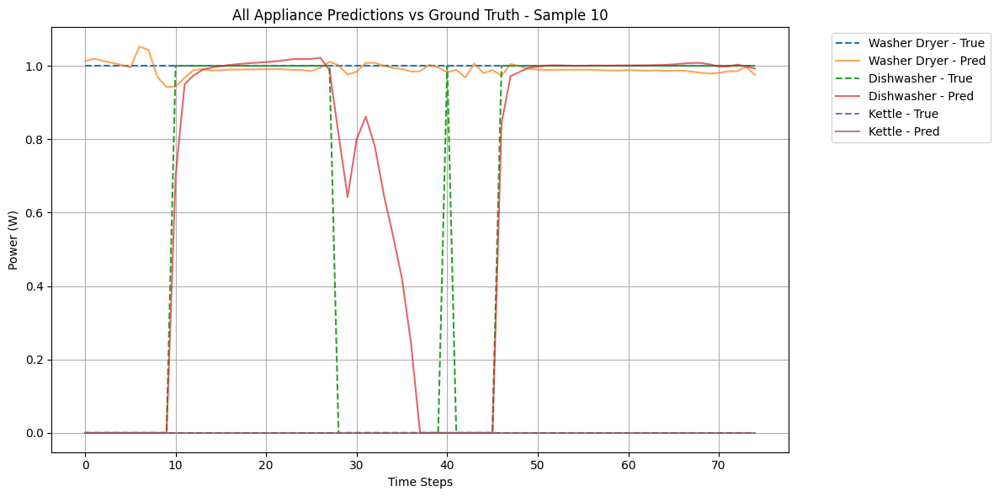

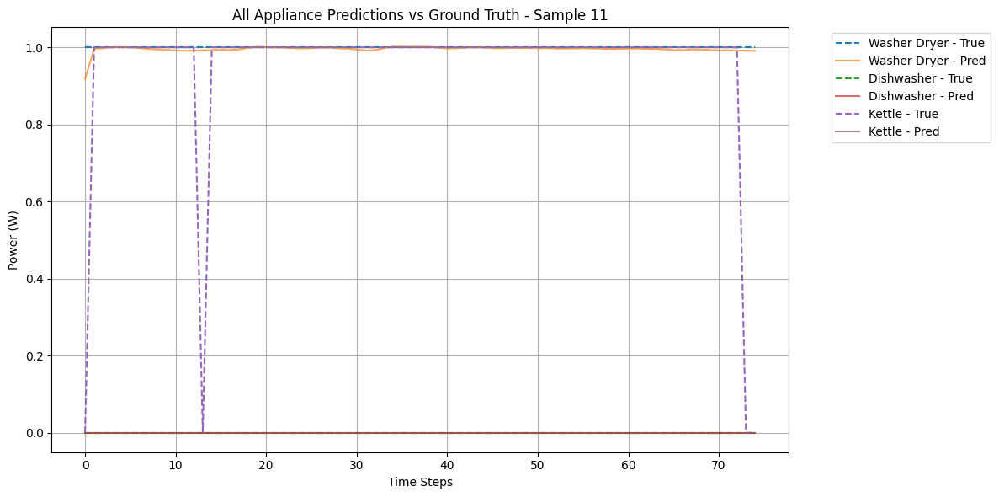

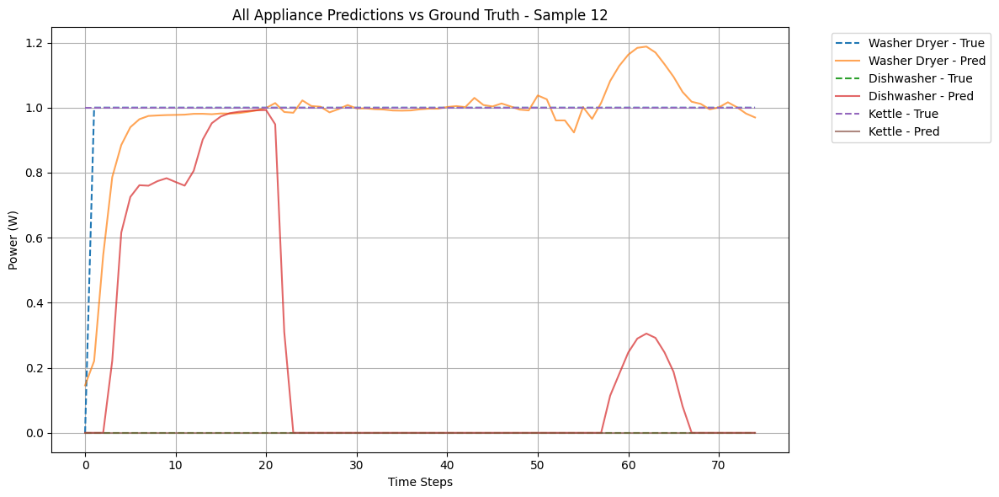

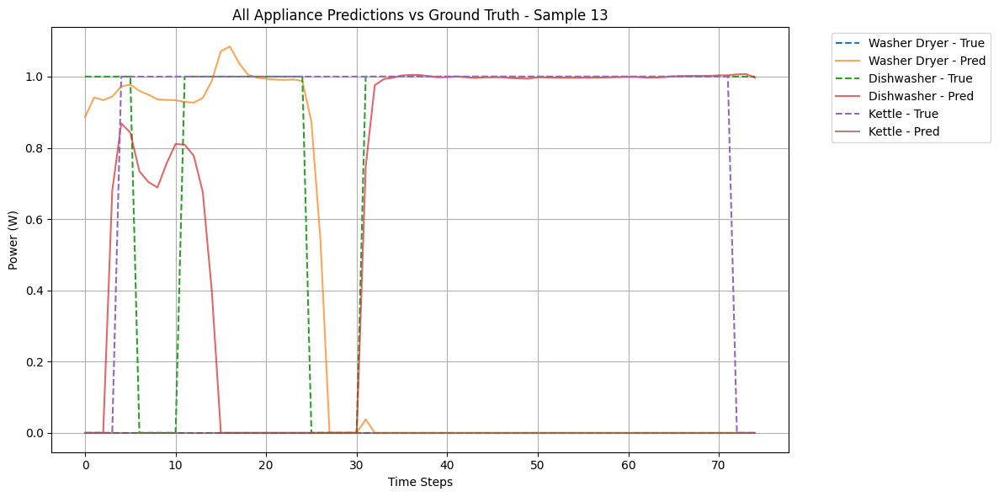

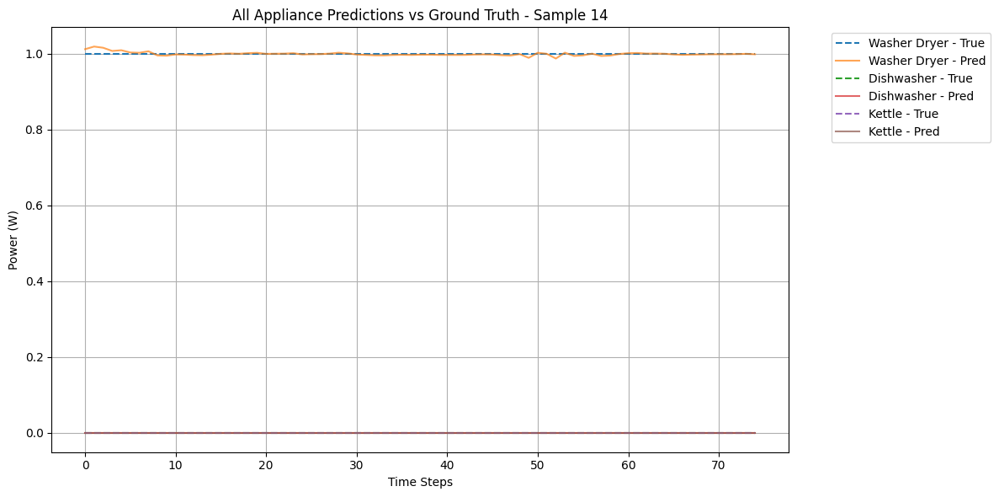

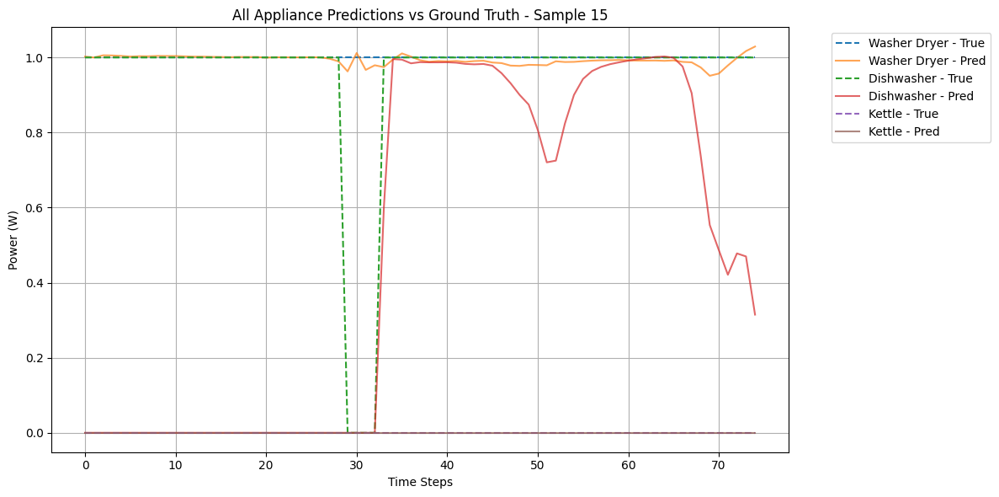

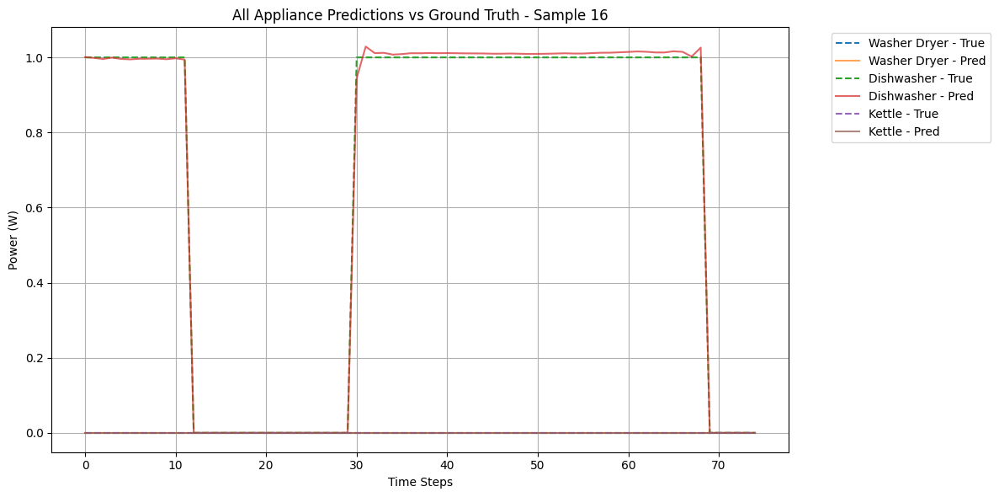

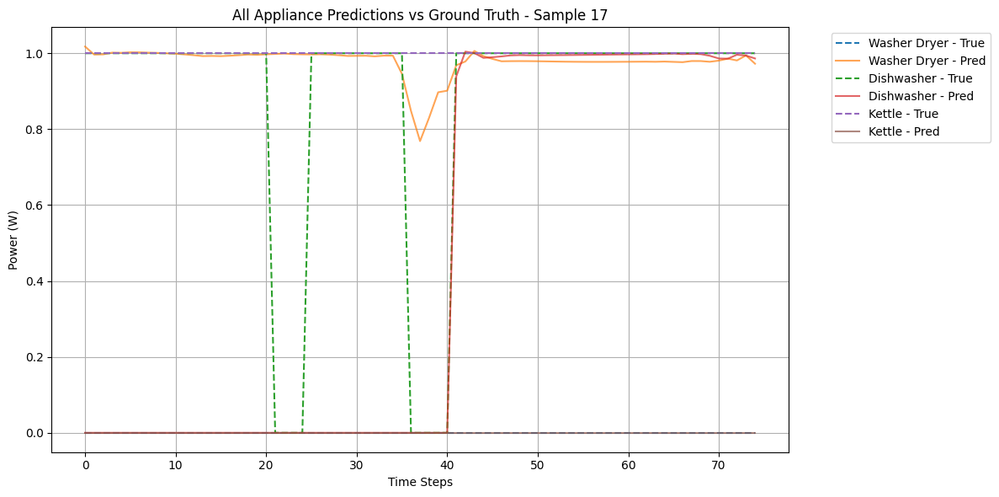

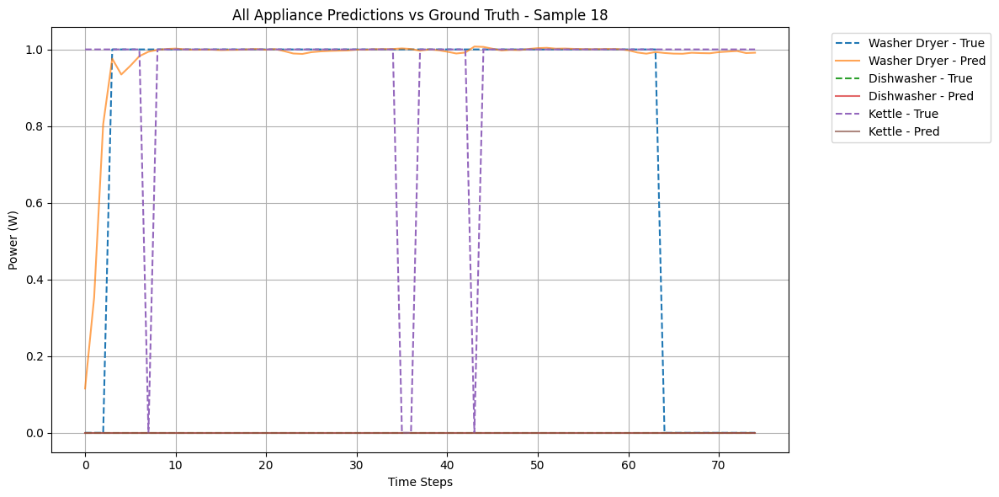

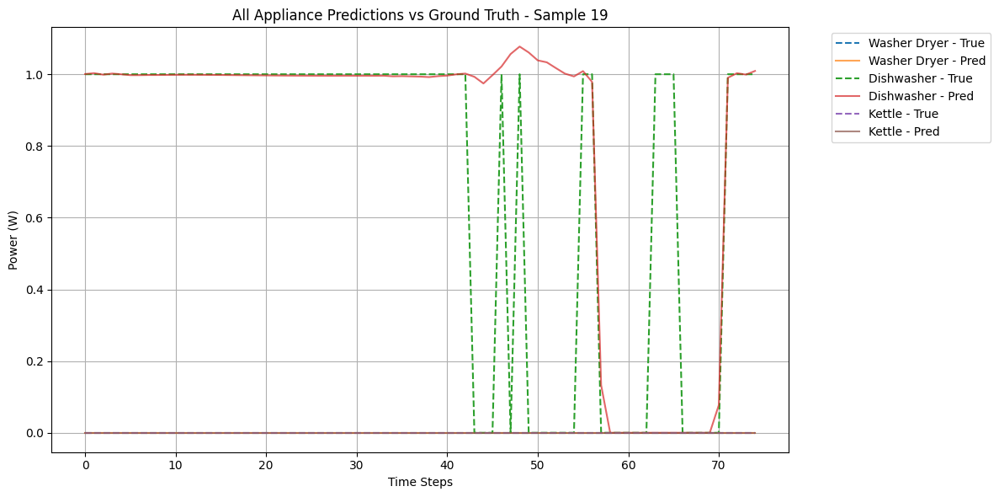

In [181]:
plot_all_appliances_multiple(Y_scaled, preds_regression, appliance_names=few_appliances, idx_start=10)


Saving and loading the model

In [ ]:
# from keras import ops
from keras.models import save_model

save_model(regression_model,'./keras_models/few_appliances_regression_model1.keras')
print('Saved model to: ./keras_models/few_appliances_regression_model1.keras')

Saved model to: few_appliances_regression_model1.keras


In [ ]:
from keras.models import load_model

regression_few_appliances_loaded_model = load_model('./keras_models/few_appliances_regression_model.keras', custom_objects={
    'relu6_div6': (relu6_div6),
    'Conv1DGLUBlock': (Conv1DGLUBlock),
    'ResidualBlock': (ResidualBlock),
    })


In [36]:
finetuned_preds_regression = classification_few_appliances_loaded_model.predict(X)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (finetuned_preds_regression > 0.5).astype(int)

print('Few Appliances Test Results:')
flatten_time_dimension(Y_scaled, finetuned_preds_regression, few_appliances)

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 87s 68ms/step
Few Appliances Test Results:

📊 Overall Test MAE: 0.17
📉 Overall Test MSE: 0.16
📈 Overall R² Score: 0.3303

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.09 | MSE: 0.08 | R²: 0.6939
Dishwasher:
  MAE: 0.12 | MSE: 0.11 | R²: 0.5308
Kettle:
  MAE: 0.31 | MSE: 0.31 | R²: -0.2339


## Final model: Finetuning

### The final model

The following cell is used to run inference, `finetune_seq2seq_regression()` doesn't add any layer to the previous model and instead unfreezes the last 2 custom layers for finetuning 

In [151]:
from keras.losses import MeanAbsoluteError, MeanSquaredError, Huber
from keras.optimizers import Adam
from keras.activations import leaky_relu

def finetune_seq2seq_regression(loaded_model, num_classes=4):

# loaded_model.summary()
    for layer in loaded_model.layers[:-29]:
        layer.trainable = False
    x = loaded_model.layers[-1].output


    seq2seq_model = Model(inputs=loaded_model.input, outputs=x)
    seq2seq_model.compile(optimizer=Adam(learning_rate=0.001), loss="mae", metrics=[MeanAbsoluteError(), MeanSquaredError()])

    # # # Summary
    seq2seq_model.summary()
    return seq2seq_model

Training the model with the same parameters and hyperparameters as before.

In [ ]:
print(f"Generated {len(X)} sequences with shape {X.shape} and labels shape {Y.shape}")
fine_tuned_model = finetune_seq2seq_regression(regression_few_appliances_loaded_model, len(few_appliances))
history_1 = fine_tuned_model.fit(X, Y_scaled, epochs=15, batch_size=64, validation_split=0.1, callbacks=[reduce_lr])

Generated 39999 sequences with shape (39999, 300, 1) and labels shape (39999, 75, 3)


Model: "functional_37"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_13      │ (None, 300, 1)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_159 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_158 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_73       │ (None, 300, 64)   │          0 │ conv1d_159[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_44         │ (None, 300, 64)   │          0 │ conv1d_158[0][0], │
│ (Multiply)          │                   │            │ activation_73[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_161 (Conv1D) │ (None, 300, 64)   │        128 │ input_layer_13[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_160 (Conv1D) │ (None, 300, 64)   │      4,160 │ multiply_44[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_44 (Add)        │ (None, 300, 64)   │          0 │ conv1d_161[0][0], │
│                     │                   │            │ conv1d_160[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_44    │ (None, 150, 64)   │          0 │ add_44[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_163 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_162 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_74       │ (None, 150, 128)  │          0 │ conv1d_163[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_45         │ (None, 150, 128)  │          0 │ conv1d_162[0][0], │
│ (Multiply)          │                   │            │ activation_74[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_165 (Conv1D) │ (None, 150, 128)  │      8,320 │ max_pooling1d_44… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_164 (Conv1D) │ (None, 150, 128)  │     16,512 │ multiply_45[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_45 (Add)        │ (None, 150, 128)  │          0 │ conv1d_165[0][0], │
│                     │                   │            │ conv1d_164[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_45    │ (None, 75, 128)   │          0 │ add_45[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_42 (Conv1D)  │ (None, 75, 128)   │     82,048 │ max_pooling1d_45… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_41 (Conv1D)  │ (None, 75, 128)   │     82,048 │ max_pooling1d_45… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_16       │ (None, 75, 128)   │          0 │ conv1d_42[0][0]   │
│ (Activation)        │                   │            │                 

 Total params: 1,373,571 (5.24 MB)

 Trainable params: 998,595 (3.81 MB)

 Non-trainable params: 374,976 (1.43 MB)

Epoch 1/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 146s 217ms/step - loss: 0.0944 - mean_absolute_error: 0.0944 - mean_squared_error: 0.0475 - val_loss: 0.0546 - val_mean_absolute_error: 0.0546 - val_mean_squared_error: 0.0188 - learning_rate: 0.0010
Epoch 2/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 121s 215ms/step - loss: 0.0544 - mean_absolute_error: 0.0544 - mean_squared_error: 0.0189 - val_loss: 0.0483 - val_mean_absolute_error: 0.0483 - val_mean_squared_error: 0.0163 - learning_rate: 0.0010
Epoch 3/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 122s 216ms/step - loss: 0.0502 - mean_absolute_error: 0.0502 - mean_squared_error: 0.0172 - val_loss: 0.0452 - val_mean_absolute_error: 0.0452 - val_mean_squared_error: 0.0143 - learning_rate: 0.0010
Epoch 4/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 126s 224ms/step - loss: 0.0472 - mean_absolute_error: 0.0472 - mean_squared_error: 0.0159 - val_loss: 0.0429 - val_mean_absolute_error: 0.0429 - val_mean_squared_error: 0.0141 - learning_rate: 0.0010
Epoch 5/15
563/563 ━━━━━━━━━━━━━━━━━━━━ 

In [ ]:
finetuned_preds_regression = fine_tuned_model.predict(X)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (finetuned_preds_regression > 0.5).astype(int)

print('Few Appliances Test Results:')
flatten_time_dimension(Y_scaled, finetuned_preds_regression, few_appliances)

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 75s 58ms/step
Few Appliances Test Results:

📊 Overall Test MAE: 0.04
📉 Overall Test MSE: 0.01
📈 Overall R² Score: 0.5110

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.06 | MSE: 0.02 | R²: 0.7491
Dishwasher:
  MAE: 0.03 | MSE: 0.01 | R²: 0.8769
Kettle:
  MAE: 0.03 | MSE: 0.01 | R²: -0.0930


Saving and loading the final model.

In [ ]:
# from keras import ops
from keras.models import save_model

save_model(fine_tuned_model,'./keras_models/finetuned_regression_model.keras')
print('Saved model to: ./keras_models/finetuned_regression_model.keras')

Saved model to: finetuned_regression_model.keras


In [ ]:
from keras.models import load_model
finetuned_loaded_model = load_model('./keras_models/finetuned_regression_model.keras', custom_objects={
    'relu6_div6': (relu6_div6),
    'Conv1DGLUBlock': (Conv1DGLUBlock),
    'ResidualBlock': (ResidualBlock),
    })


### Predictions

The predictions and the metrics computed show how well the model does: MAE and MSE show if the model is often wrong and R² shows if the model is able to understand properly the variations

In [169]:
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))
print(X_test.shape)
loaded_finetuned_preds_regression_test = fine_tuned_model.predict(X_test)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (loaded_finetuned_preds_regression > 0.5).astype(int)

print('Few Appliances Test Results:')
flatten_time_dimension(Y_test_scaled,loaded_finetuned_preds_regression_test, few_appliances)

(10000, 300, 1)
313/313 ━━━━━━━━━━━━━━━━━━━━ 15s 48ms/step
Few Appliances Test Results:

📊 Overall Test MAE: 0.05
📉 Overall Test MSE: 0.03
📈 Overall R² Score: -0.3692

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.08 | MSE: 0.04 | R²: -1.1096
Dishwasher:
  MAE: 0.07 | MSE: 0.05 | R²: 0.0108
Kettle:
  MAE: 0.01 | MSE: 0.01 | R²: -0.0088


### Plots of synthetic and real-life results

The following plots compare the predictions of the power consumption per appliance to the truth for both the synthetic dataset and the real-life dataset

In [20]:
plot_all_appliances_multiple(Y_scaled, loaded_finetuned_preds_regression, appliance_names=few_appliances, idx_start=120)


NameError: name 'loaded_finetuned_preds_regression' is not defined

In [41]:
flatten_time_dimension(Y_test_scaled, loaded_finetuned_preds_regression_test, few_appliances)


📊 Overall Test MAE: 0.02
📉 Overall Test MSE: 0.02
📈 Overall R² Score: -1.4166

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.03 | MSE: 0.02 | R²: -2.8633
Dishwasher:
  MAE: 0.02 | MSE: 0.02 | R²: -0.4474
Kettle:
  MAE: 0.01 | MSE: 0.01 | R²: -0.9451


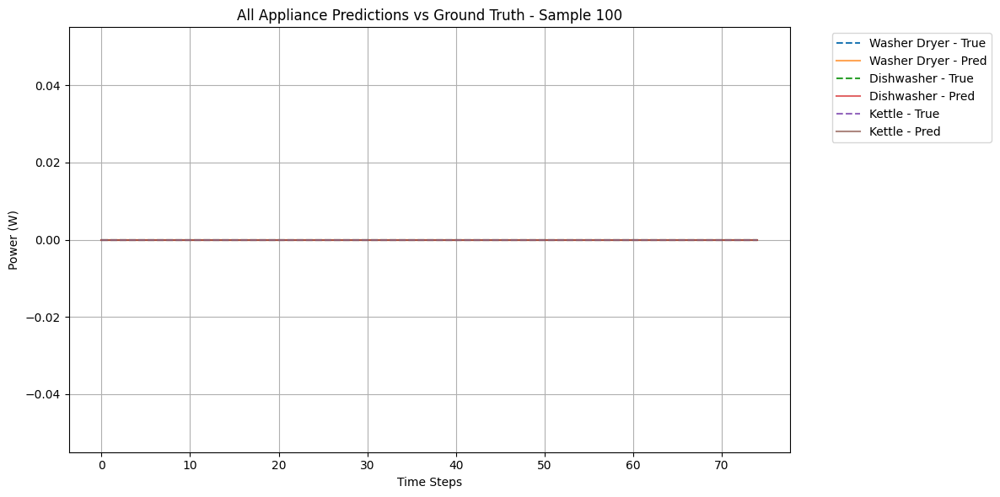

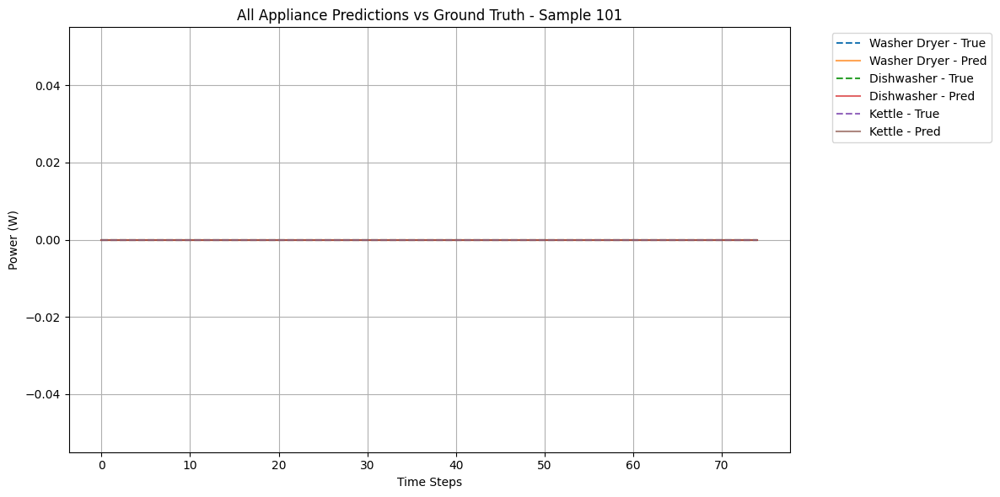

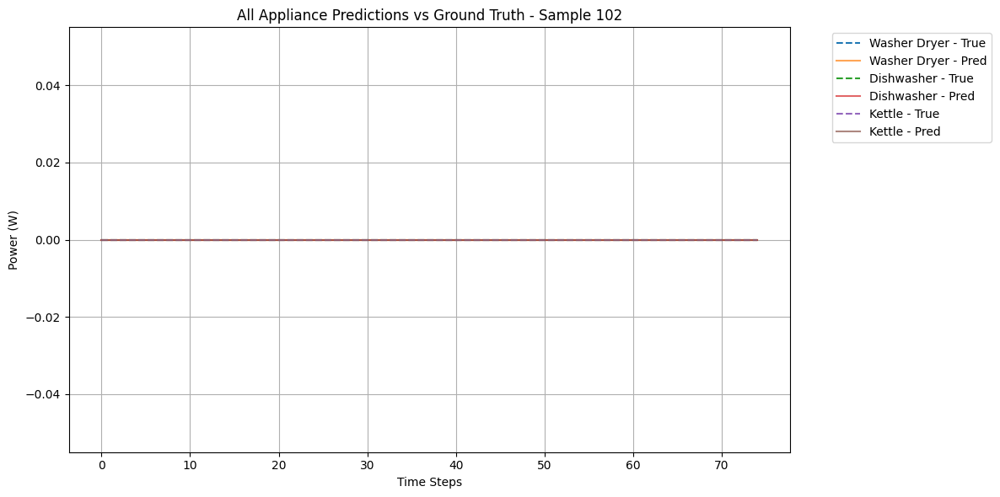

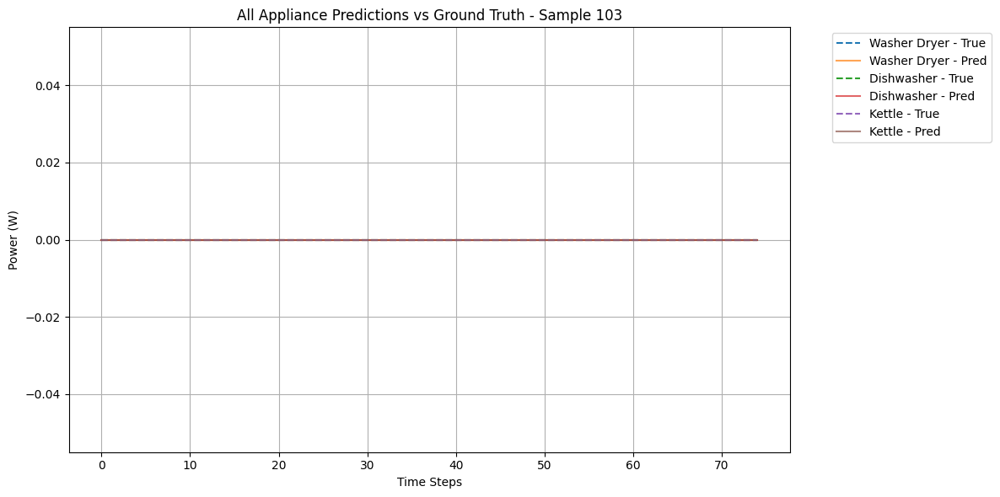

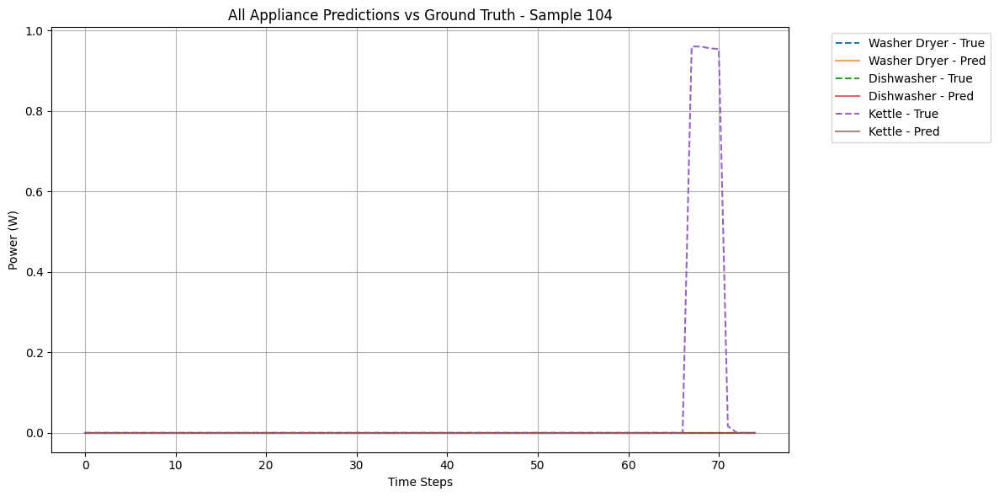

...

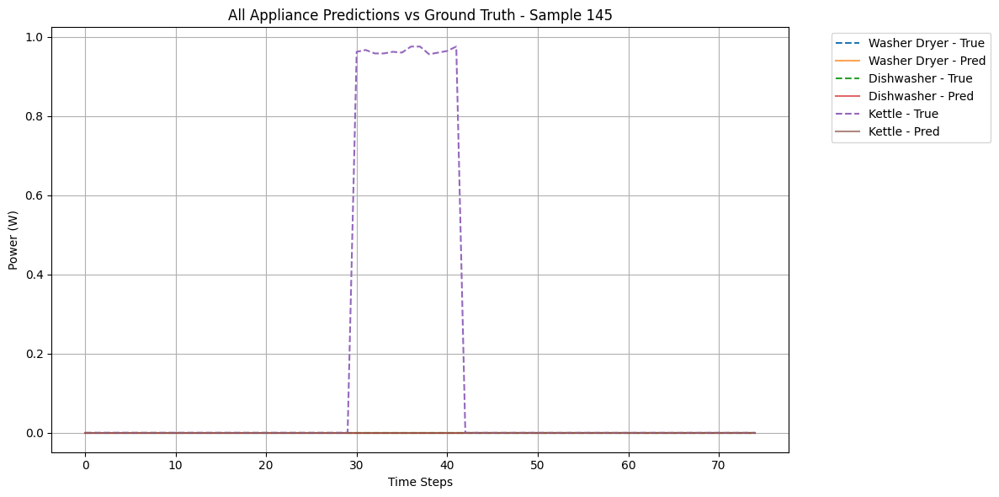

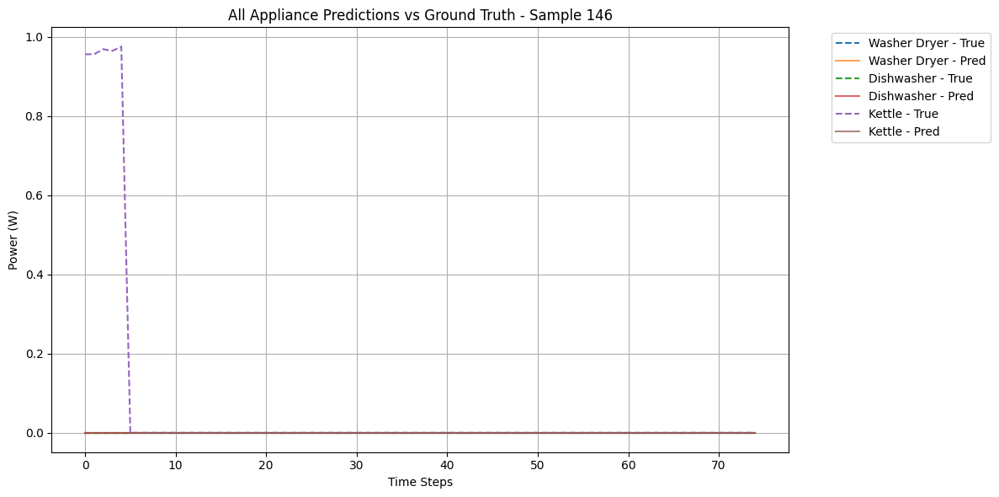

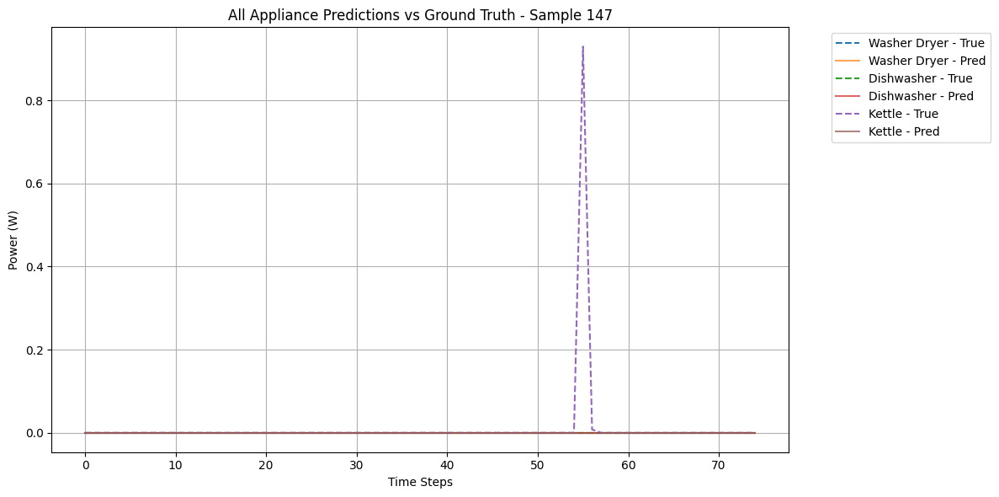

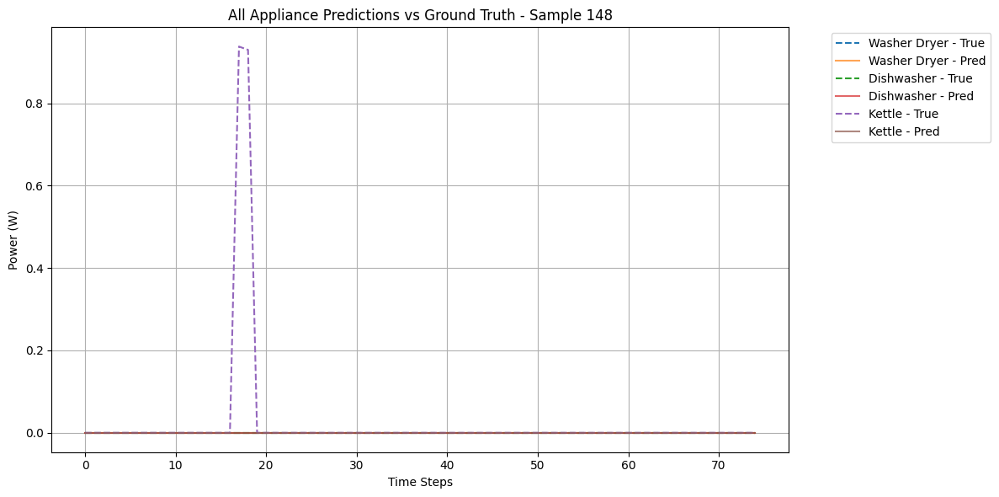

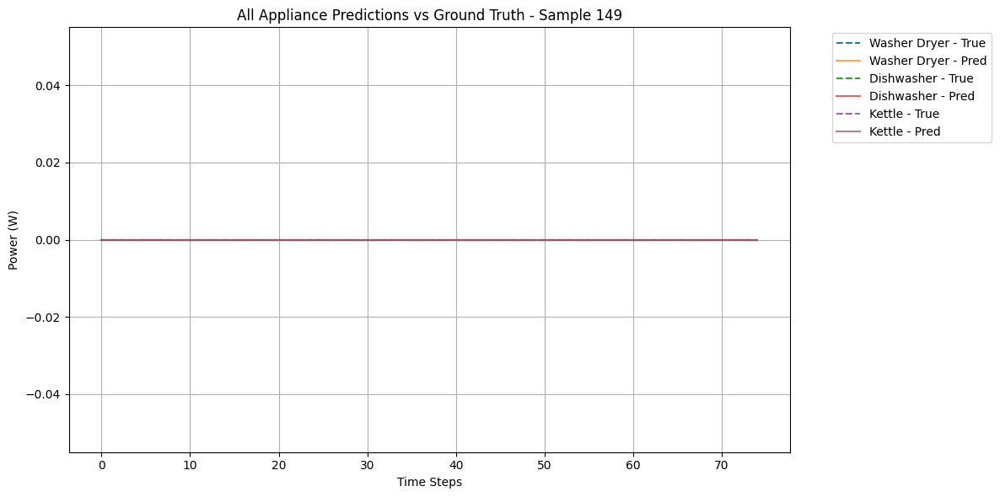

In [61]:
plot_all_appliances_multiple(Y_test_scaled, second_loaded_finetuned_preds_regression_test, appliance_names=labels_test, idx_start=100, count=50)


In [ ]:
import pandas as pd
import numpy as np

# Save numpy arrays as CSV using pandas DataFrame
print('shape of X', X.shape)
print('shape of X_test', X_test.shape)
print('shape of y', Y_scaled.shape)
print('shape of y_test', Y_test_scaled.shape)
pd.DataFrame(X.squeeze()).to_csv(f'{DATA_DIR}/Synthetic_Aggregate.csv', index=False)
# For 3D arrays, flatten the last dimension or reshape as needed
pd.DataFrame(Y_scaled.reshape(-1, Y_scaled.shape[-1])).to_csv(f'{DATA_DIR}/Synthetic_Y.csv', index=False)
pd.DataFrame(X_test.squeeze()).to_csv(f'{DATA_DIR}/IRL_Aggregate.csv', index=False)
pd.DataFrame(Y_test_scaled.reshape(-1, Y_test_scaled.shape[-1])).to_csv(f'{DATA_DIR}/IRL_Y.csv', index=False)


shape of X (39999, 300, 1)
shape of X_test (10000, 300, 1)
shape of y (39999, 75, 3)
shape of y_test (10000, 75, 3)


## Converting the final model

The following cells save the parameters used to scale the values. This enable, later on, to unscale the values to have the results in Watts for the predictions.

In [197]:
# Save parameters
params = {
    'min_': scaler_Y.min_,
    'scale_': scaler_Y.scale_,
    'data_min_': scaler_Y.data_min_,
    'data_max_': scaler_Y.data_max_,
    'data_range_': scaler_Y.data_range_,
}

import json
with open('scaler_params_Y.json', 'w') as f:
    json.dump({k: v.tolist() for k, v in params.items()}, f)

In [198]:
# Save parameters
params = {
    'min_': scaler_y_test.min_,
    'scale_': scaler_y_test.scale_,
    'data_min_': scaler_y_test.data_min_,
    'data_max_': scaler_y_test.data_max_,
    'data_range_': scaler_y_test.data_range_,
}

import json
with open('scaler_params_y_test.json', 'w') as f:
    json.dump({k: v.tolist() for k, v in params.items()}, f)

In [ ]:
### ENTER CODE HERE
converter = tf.lite.TFLiteConverter.from_keras_model(finetuned_loaded_model)
converter.target_spec.supported_ops = [
    tf.lite.OpsSet.TFLITE_BUILTINS,       # Standard TFLite ops
    tf.lite.OpsSet.SELECT_TF_OPS          # TensorFlow ops fallback
]

# Optional: if using custom layers, enable this too
converter._experimental_lower_tensor_list_ops = False

# Convert model
tflite_model = converter.convert()

# tflite_model = converter.convert()

import pathlib
# tflite_models_dir = pathlib.Path("./mnist_tflite_models/")
# tflite_models_dir.mkdir(exist_ok=True, parents=True)

# Save the unquantized float model:
tflite_model_file = pathlib.Path("./tflite_models/model.tflite")
tflite_model_file.write_bytes(tflite_model)

INFO:tensorflow:Assets written to: C:\Users\niran\AppData\Local\Temp\tmp5u487c9v\assets


INFO:tensorflow:Assets written to: C:\Users\niran\AppData\Local\Temp\tmp5u487c9v\assets


Saved artifact at 'C:\Users\niran\AppData\Local\Temp\tmp5u487c9v'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 300, 1), dtype=tf.float32, name='input_layer_13')
Output Type:
  TensorSpec(shape=(None, 75, 3), dtype=tf.float32, name=None)
Captures:
  2218497360720: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218497369744: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218497373776: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218497374160: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218497362256: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218949638864: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218949632720: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218949626192: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218949633680: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218949638288: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2218

5570628

## Pruning & Quantizing

In [ ]:
from keras.models import load_model

finetuned_model = load_model('./keras_models/finetuned_regression_model.keras', custom_objects={
    'relu6_div6': (relu6_div6),
    'Conv1DGLUBlock': (Conv1DGLUBlock),
    'ResidualBlock': (ResidualBlock),
    })

In [185]:
### ENTER CODE HERE
def get_gzipped_model_size(file):
  # Returns size of gzipped model, in bytes.
  import os
  import zipfile

  _, zipped_file = tempfile.mkstemp('.zip')
  with zipfile.ZipFile(zipped_file, 'w', compression=zipfile.ZIP_DEFLATED) as f:
    f.write(file)

  return os.path.getsize(zipped_file)

print("Size of gzipped baseline Keras model: %.2f bytes" % (get_gzipped_model_size('finetuned_regression_model.keras')))


Size of gzipped baseline Keras model: 12443211.00 bytes


In [175]:
import tensorflow
from tensorflow.keras.layers import Input, Dense, LSTM, Bidirectional, MaxPooling1D
# from tf.keras.models import Model

def build_model():
    """
    Builds  the seq2se model for pruning.
    """
    X = tensorflow.keras.layers.Input(shape=(300, 1), name='input_signal')
    seq2seq = ResidualBlock(filters=64, kernel_size=5)(X)
    seq2seq = tensorflow.keras.layers.MaxPooling1D(pool_size=2, strides=2)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = tensorflow.keras.layers.MaxPooling1D(pool_size=2, strides=2)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=5)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = tensorflow.keras.layers.Bidirectional(LSTM(64, return_sequences=True))(seq2seq)
    seq2seq = ResidualBlock(filters=256, kernel_size=7)(seq2seq)
    seq2seq = ResidualBlock(filters=64, kernel_size=3)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = tensorflow.keras.layers.LSTM(64, return_sequences=True)(seq2seq)
    Dense_output = tensorflow.keras.layers.Dense(3, activation='relu')(seq2seq)
    model = tensorflow.keras.Model(inputs=X, outputs=Dense_output)
    return model


In [107]:
import tensorflow_model_optimization as tfmot
from keras.models import clone_model
from keras.optimizers import Adam
print(type(finetuned_model))
number_images = X.shape[0]
batch_size = 64 
epochs = 1

end_step = np.ceil(number_images/batch_size).astype(np.int32)*epochs

prune_low_magnitude = tfmot.sparsity.keras.prune_low_magnitude
base_model = build_model()
base_model.load_weights('finetuned_regression_model.keras')
print(type(base_model))

# base_model.load_weights(pretrained_weights)

prune_low_magnitude = tfmot.sparsity.keras.prune_low_magnitude

def apply_pruning_to_dense(layer):
  if isinstance(layer, keras.layers.Dense):
    return tfmot.sparsity.keras.prune_low_magnitude(layer)
  return layer

# Use `keras.models.clone_model` to apply `apply_pruning_to_dense` 
# to the layers of the model.
model_for_pruning = clone_model(
    base_model,
    clone_function=apply_pruning_to_dense,
)

# pruning_params = {
#     "pruning_schedule": tfmot.sparsity.keras.PolynomialDecay(
#         initial_sparsity=0.,
#         final_sparsity=0.,
#         begin_step=0,
#         end_step=end_step
#     )
# }

# # Example: wrap a model in pruning
# model_for_pruning = prune_low_magnitude(build_model(), **pruning_params)

model_for_pruning.compile(loss='mae',
              optimizer=Adam(),
              metrics=['mse', 'mae'])

model_for_pruning.summary()

<class 'keras.src.models.functional.Functional'>
<class 'keras.src.models.functional.Functional'>


Model: "functional_28"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_signal        │ (None, 300, 1)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_725 (Conv1D) │ (None, 300, 64)   │        384 │ input_signal[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_724 (Conv1D) │ (None, 300, 64)   │        384 │ input_signal[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_196      │ (None, 300, 64)   │          0 │ conv1d_725[1][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_196        │ (None, 300, 64)   │          0 │ conv1d_724[1][0], │
│ (Multiply)          │                   │            │ activation_196[1… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_727 (Conv1D) │ (None, 300, 64)   │        128 │ input_signal[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_726 (Conv1D) │ (None, 300, 64)   │      4,160 │ multiply_196[1][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_196 (Add)       │ (None, 300, 64)   │          0 │ conv1d_727[1][0], │
│                     │                   │            │ conv1d_726[1][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_56    │ (None, 150, 64)   │          0 │ add_196[1][0]     │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_729 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_56… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_728 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_56… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_197      │ (None, 150, 128)  │          0 │ conv1d_729[1][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_197        │ (None, 150, 128)  │          0 │ conv1d_728[1][0], │
│ (Multiply)          │                   │            │ activation_197[1… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_731 (Conv1D) │ (None, 150, 128)  │      8,320 │ max_pooling1d_56… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_730 (Conv1D) │ (None, 150, 128)  │     16,512 │ multiply_197[1][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_197 (Add)       │ (None, 150, 128)  │          0 │ conv1d_731[1][0], │
│                     │                   │            │ conv1d_730[1][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_57    │ (None, 75, 128)   │          0 │ add_197[1][0]     │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_733 (Conv1D) │ (None, 75, 128)   │     82,048 │ max_pooling1d_57… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_732 (Conv1D) │ (None, 75, 128)   │     82,048 │ max_pooling1d_57… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_198      │ (None, 75, 128)   │          0 │ conv1d_733[1][0]  │
│ (Activation)        │                   │            │                 

 Total params: 1,274,755 (4.86 MB)

 Trainable params: 1,274,755 (4.86 MB)

 Non-trainable params: 0 (0.00 B)

In [95]:
callbacks = [
  tfmot.sparsity.keras.UpdatePruningStep(),
  # tfmot.sparsity.keras.PruningSummaries(log_dir=logdir),
]
# with tf.device('.cpu:0'):
history1 = model_for_pruning.fit(X, Y_scaled,
                  batch_size=batch_size, epochs=epochs,
                  callbacks=callbacks,validation_split=0.1)

563/563 ━━━━━━━━━━━━━━━━━━━━ 134s 219ms/step - loss: 0.1276 - mae: 0.1276 - mse: 0.0750 - val_loss: 0.1250 - val_mae: 0.1250 - val_mse: 0.0724


In [96]:
pruned_model = model_for_pruning.predict(X)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (finetuned_preds_regression > 0.5).astype(int)

print('Few Appliances Test Results:')
flatten_time_dimension(Y_scaled, pruned_model, few_appliances)

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 60s 47ms/step
Few Appliances Test Results:

📊 Overall Test MAE: 0.12
📉 Overall Test MSE: 0.07
📈 Overall R² Score: -0.3054

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.18 | MSE: 0.10 | R²: -0.4977
Dishwasher:
  MAE: 0.16 | MSE: 0.11 | R²: -0.3254
Kettle:
  MAE: 0.03 | MSE: 0.01 | R²: -0.0930


In [ ]:
from keras.models import save_model
model_for_export = tfmot.sparsity.keras.strip_pruning(model_for_pruning)
save_model(model_for_export,'./keras_models/pruned_model.keras')
print('Saved model to: ./keras_models/pruned_model.keras')

ValueError: ('Expected model to be a `keras.Model` instance but got: ', <Functional name=functional_21, built=True>)

In [ ]:
print("Size of gzipped baseline Keras model: %.2f bytes" % (get_gzipped_model_size('./keras_models/finetuned_regression_model.keras')))
print("Size of gzipped pruned model: %.2f bytes" % (get_gzipped_model_size('./keras_models/pruned_model.keras')))
print("Reduced size by: %.2f" % ((get_gzipped_model_size('./keras_models/finetuned_regression_model.keras')/get_gzipped_model_size('./keras_models/pruned_model.keras'))))

Size of gzipped baseline Keras model: 6046141.00 bytes
Size of gzipped pruned model: 13012621.00 bytes
Reduced size by: 0.46


In [ ]:
def convert_model_to_tflite(quantize_by = 16):
    from pathlib import Path
    model_path = Path("./keras_models/finetuned_regression_model.keras").resolve()
    output_path = Path(f"./tflite_models/quant{quantize_by}model.tflite").resolve()
    print(f"🔍 Loading model from: {model_path}")
    model = load_model(model_path, custom_objects={
        'relu6_div6': relu6_div6,
        'Conv1DGLUBlock': Conv1DGLUBlock,
        'ResidualBlock': ResidualBlock,
    })

    print("🔄 Converting to TFLite format...")
    converter = tf.lite.TFLiteConverter.from_keras_model(model)
    # converter.allow_custom_ops = True
    converter.target_spec.supported_ops = [
    tf.lite.OpsSet.TFLITE_BUILTINS,
    tf.lite.OpsSet.SELECT_TF_OPS
    ]
    converter._experimental_lower_tensor_list_ops = False
    # # Optional optimizations
    converter.optimizations = [tf.lite.Optimize.DEFAULT]
    if quantize_by == 16:
        # Quantize to float16
        converter.target_spec.supported_types = [tf.float16]
    elif quantize_by == 8:
        # Quantize to int8
        # converter.target_spec.supported_types = [tf.lite.Optimize.DEFAULT]
        pass
    else:
        print("❌ Unsupported quantization type. Use 8 or 16.")
        return

    # converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS]
    try:
        tflite_model = converter.convert()
    except Exception as e:
        print("❌ Conversion failed:", e)
        return

    # Save TFLite model
    with open(output_path, 'wb') as f:
        f.write(tflite_model)
    print(f"✅ TFLite model saved to: {output_path}")



In [186]:
convert_model_to_tflite()

🔍 Loading model from: C:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Model\CNN\finetuned_regression_model.keras
🔄 Converting to TFLite format...
INFO:tensorflow:Assets written to: C:\Users\niran\AppData\Local\Temp\tmp5li_181k\assets


INFO:tensorflow:Assets written to: C:\Users\niran\AppData\Local\Temp\tmp5li_181k\assets


Saved artifact at 'C:\Users\niran\AppData\Local\Temp\tmp5li_181k'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 300, 1), dtype=tf.float32, name='input_layer_13')
Output Type:
  TensorSpec(shape=(None, 75, 3), dtype=tf.float32, name=None)
Captures:
  2221835649488: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835658128: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835658320: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835658896: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835659088: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835659664: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835659856: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835660432: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835660624: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221835661200: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221

In [ ]:
print("Float model in Mb:", os.path.getsize('./tflite_models/model.tflite') / float(2**20))
print("Quantized 16-bit model in Mb:", os.path.getsize('./tflite_models/quant16model.tflite') / float(2**20))
print("Compression ratio:", os.path.getsize('./tflite_models/model.tflite')/os.path.getsize('./tflite_models/quant16model.tflite'))

Float model in Mb: 13.101664543151855
Quantized 16-bit model in Mb: 2.701091766357422
Compression ratio: 4.850507008438371


In [188]:
convert_model_to_tflite(quantize_by=8)

🔍 Loading model from: C:\Users\niran\OneDrive\Documents\UL\Edge Computing\Project\NILM\NILM_Project\Model\CNN\finetuned_regression_model.keras
🔄 Converting to TFLite format...
INFO:tensorflow:Assets written to: C:\Users\niran\AppData\Local\Temp\tmpvgvse5yr\assets


INFO:tensorflow:Assets written to: C:\Users\niran\AppData\Local\Temp\tmpvgvse5yr\assets


Saved artifact at 'C:\Users\niran\AppData\Local\Temp\tmpvgvse5yr'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 300, 1), dtype=tf.float32, name='input_layer_13')
Output Type:
  TensorSpec(shape=(None, 75, 3), dtype=tf.float32, name=None)
Captures:
  2221227217488: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227218640: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227218832: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227219408: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227219600: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227220176: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227220368: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227220944: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227221136: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221227221712: TensorSpec(shape=(), dtype=tf.resource, name=None)
  2221

In [5]:
print("Float model in Mb:", os.path.getsize('./keras_models/finetuned_regression_model.keras') / float(2**20))
print("Float model in Mb:", os.path.getsize('./tflite_models/model.tflite') / float(2**20))
print("Quantized 8-bit model in Mb:", os.path.getsize('./tflite_models/quant8model.tflite') / float(2**20))
print("Compression ratio:", os.path.getsize('./tflite_models/model.tflite')/os.path.getsize('./tflite_models/quant8model.tflite'))

Float model in Mb: 13.101664543151855
Float model in Mb: 5.312564849853516
Quantized 8-bit model in Mb: 1.4644927978515625
Compression ratio: 3.627580045219167


In [142]:

def build_untrained_model(input_length = 300, num_classes=3):
    """
    Builds  the seq2se model for pruning.
    """
    X = Input(shape=(input_length, 1))
    print(f"Input shape: {X.shape}")
    seq2seq = ResidualBlock(filters=64, kernel_size=5)(X)
    seq2seq = MaxPooling1D(pool_size=2, strides=2)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = MaxPooling1D(pool_size=2, strides=2)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=5)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = Bidirectional(LSTM(64, return_sequences=True))(seq2seq)
    seq2seq = ResidualBlock(filters=256, kernel_size=7)(seq2seq)
    seq2seq = ResidualBlock(filters=64, kernel_size=3)(seq2seq)
    seq2seq = ResidualBlock(filters=128, kernel_size=3)(seq2seq)
    seq2seq = LSTM(64, return_sequences=True)(seq2seq)
    Dense_output = Dense(num_classes, activation='relu')(seq2seq)
    model = tensorflow.keras.Model(inputs=X, outputs=Dense_output)
    model.compile(optimizer=Adam(learning_rate=0.001), loss="mae", metrics=["mae", "mse"])
    model.summary()
    return model

In [180]:

print(f"Generated {len(X)} sequences with shape {X.shape} and labels shape {Y.shape}")
untrained_model = build_untrained_model(300,len(few_appliances))
history_1 = untrained_model.fit(X, Y_scaled, epochs=5, batch_size=64, validation_split=0.1, callbacks=[reduce_lr])

Generated 39999 sequences with shape (39999, 300, 1) and labels shape (39999, 75, 3)
Input shape: (None, 300, 1)


Model: "functional_38"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 300, 1)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_959 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_958 (Conv1D) │ (None, 300, 64)   │        384 │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_259      │ (None, 300, 64)   │          0 │ conv1d_959[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_259        │ (None, 300, 64)   │          0 │ conv1d_958[0][0], │
│ (Multiply)          │                   │            │ activation_259[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_961 (Conv1D) │ (None, 300, 64)   │        128 │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_960 (Conv1D) │ (None, 300, 64)   │      4,160 │ multiply_259[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_259 (Add)       │ (None, 300, 64)   │          0 │ conv1d_961[0][0], │
│                     │                   │            │ conv1d_960[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_74    │ (None, 150, 64)   │          0 │ add_259[0][0]     │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_963 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_74… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_962 (Conv1D) │ (None, 150, 128)  │     24,704 │ max_pooling1d_74… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_260      │ (None, 150, 128)  │          0 │ conv1d_963[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_260        │ (None, 150, 128)  │          0 │ conv1d_962[0][0], │
│ (Multiply)          │                   │            │ activation_260[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_965 (Conv1D) │ (None, 150, 128)  │      8,320 │ max_pooling1d_74… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_964 (Conv1D) │ (None, 150, 128)  │     16,512 │ multiply_260[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_260 (Add)       │ (None, 150, 128)  │          0 │ conv1d_965[0][0], │
│                     │                   │            │ conv1d_964[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_75    │ (None, 75, 128)   │          0 │ add_260[0][0]     │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_967 (Conv1D) │ (None, 75, 128)   │     82,048 │ max_pooling1d_75… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_966 (Conv1D) │ (None, 75, 128)   │     82,048 │ max_pooling1d_75… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_261      │ (None, 75, 128)   │          0 │ conv1d_967[0][0]  │
│ (Activation)        │                   │            │                 

 Total params: 1,274,755 (4.86 MB)

 Trainable params: 1,274,755 (4.86 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/5
563/563 ━━━━━━━━━━━━━━━━━━━━ 130s 212ms/step - loss: 0.1243 - mae: 0.1243 - mse: 0.0717 - val_loss: 0.1250 - val_mae: 0.1250 - val_mse: 0.0724 - learning_rate: 0.0010
Epoch 2/5
563/563 ━━━━━━━━━━━━━━━━━━━━ 129s 229ms/step - loss: 0.1240 - mae: 0.1240 - mse: 0.0719 - val_loss: 0.1250 - val_mae: 0.1250 - val_mse: 0.0724 - learning_rate: 0.0010
Epoch 3/5
563/563 ━━━━━━━━━━━━━━━━━━━━ 130s 230ms/step - loss: 0.1233 - mae: 0.1233 - mse: 0.0714 - val_loss: 0.1250 - val_mae: 0.1250 - val_mse: 0.0724 - learning_rate: 0.0010
Epoch 4/5
563/563 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step - loss: 0.1241 - mae: 0.1241 - mse: 0.0719
Epoch 4: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
563/563 ━━━━━━━━━━━━━━━━━━━━ 123s 219ms/step - loss: 0.1241 - mae: 0.1241 - mse: 0.0719 - val_loss: 0.1250 - val_mae: 0.1250 - val_mse: 0.0724 - learning_rate: 0.0010
Epoch 5/5
563/563 ━━━━━━━━━━━━━━━━━━━━ 123s 218ms/step - loss: 0.1240 - mae: 0.1240 - mse: 0.0720 - val_loss: 0.1250 - val_mae: 0.

In [181]:
preds_regression_untrained = untrained_model.predict(X)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (preds_regression_untrained > 0.5).astype(int)

print('Heavy Appliance Test Results:')
flatten_time_dimension(Y_scaled, preds_regression_untrained, few_appliances)

1250/1250 ━━━━━━━━━━━━━━━━━━━━ 53s 41ms/step
Heavy Appliance Test Results:

📊 Overall Test MAE: 0.12
📉 Overall Test MSE: 0.07
📈 Overall R² Score: -0.3054

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.18 | MSE: 0.10 | R²: -0.4977
Dishwasher:
  MAE: 0.16 | MSE: 0.11 | R²: -0.3254
Kettle:
  MAE: 0.03 | MSE: 0.01 | R²: -0.0930


In [182]:
preds_regression_untrained = untrained_model.predict(X_test)

# Threshold predictions to 0/1 (optional: use different threshold)
# preds_regression_binary = (preds_regression_untrained > 0.5).astype(int)

print('Heavy Appliance Test Results:')
flatten_time_dimension(Y_test_scaled, preds_regression_untrained, few_appliances)

313/313 ━━━━━━━━━━━━━━━━━━━━ 12s 39ms/step
Heavy Appliance Test Results:

📊 Overall Test MAE: 0.03
📉 Overall Test MSE: 0.03
📈 Overall R² Score: -0.0478

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.02 | MSE: 0.02 | R²: -0.0251
Dishwasher:
  MAE: 0.06 | MSE: 0.06 | R²: -0.0616
Kettle:
  MAE: 0.01 | MSE: 0.01 | R²: -0.0565


In [ ]:
save_model(untrained_model,'./keras_models/untrained_model.keras')
print('Saved model to: ./keras_models/untrained_model.keras')

Saved model to: untrained_model.keras


In [205]:
import numpy as np
import tensorflow as tf

def tflite_predict(interpreter, X):
    input_details = interpreter.get_input_details()
    output_details = interpreter.get_output_details()

    input_index = input_details[0]['index']
    output_index = output_details[0]['index']

    preds = []
    for i in range(X.shape[0]):
        input_data = X[i:i+1].astype(np.float32)
        interpreter.set_tensor(input_index, input_data)
        interpreter.invoke()
        output = interpreter.get_tensor(output_index)
        preds.append(output[0])
    return np.array(preds)

# Usage example in Jupyter:
# Load your TFLite model once
interpreter = tf.lite.Interpreter(model_path="quant8model.tflite")
interpreter.allocate_tensors()

# Assume X_test is already loaded and preprocessed exactly as for Keras predict
predictions = tflite_predict(interpreter, X[:1000])

# Now you can call your evaluation function exactly as before:
print('Heavy Appliance Test Results:')
flatten_time_dimension(Y_scaled[:1000], predictions, few_appliances)


c:\Users\niran\miniconda3\envs\cpu_env\Lib\site-packages\tensorflow\lite\python\interpreter.py:457: UserWarning:     Warning: tf.lite.Interpreter is deprecated and is scheduled for deletion in
    TF 2.20. Please use the LiteRT interpreter from the ai_edge_litert package.
    See the [migration guide](https://ai.google.dev/edge/litert/migration)
    for details.
    
  warnings.warn(_INTERPRETER_DELETION_WARNING)


Heavy Appliance Test Results:

📊 Overall Test MAE: 0.04
📉 Overall Test MSE: 0.02
📈 Overall R² Score: 0.4738

🔍 Per-Appliance Regression Metrics:
['Washer Dryer', 'Dishwasher', 'Kettle']
Washer Dryer:
  MAE: 0.06 | MSE: 0.02 | R²: 0.7125
Dishwasher:
  MAE: 0.04 | MSE: 0.02 | R²: 0.7990
Kettle:
  MAE: 0.03 | MSE: 0.01 | R²: -0.0901
